In [ ]:
! pip install grad_cam

In [ ]:
! pip install grad-cam

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy
import splitfolders
import torch.nn.functional as F
import cv2
from sklearn import decomposition
from sklearn import manifold

In [5]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((320,240)),
#         transforms.ColorJitter(brightness=.5, hue=.3),
        transforms.RandomApply(transforms=[transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))], p=0.25),
        transforms.RandomPerspective(distortion_scale=0.6, p=0.25),
        # transforms.RandomApply(transforms=[transforms.ColorJitter(brightness=.5, hue=.3),transforms.RandomInvert()], p=0.25),
        transforms.RandomApply(transforms=[transforms.ColorJitter(brightness=.5, hue=.3),
                                           # transforms.RandomInvert(),
                                           transforms.RandomAffine(30,translate=(0.1,0.1),
                                                                   shear=(-15,15))], p=0.25),
#         transforms.Grayscale(num_output_channels=3),
#         transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(0.25),
#         transforms.RandomRotation(30),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((320,240)),
#         transforms.Grayscale(num_output_channels=3),
        # transforms.Resize(256),
#         transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}
data_dir = "/home/cse/Rifat/HaSPeR/latest/data2"
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=8,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") #SELECT GPU FROM HERE|
# device = "cpu"

torch.Size([3, 320, 240])
torch.Size([3, 320, 240])
torch.Size([3, 320, 240])
torch.Size([3, 320, 240])
torch.Size([3, 320, 240])
torch.Size([3, 320, 240])
torch.Size([3, 320, 240])
torch.Size([3, 320, 240])


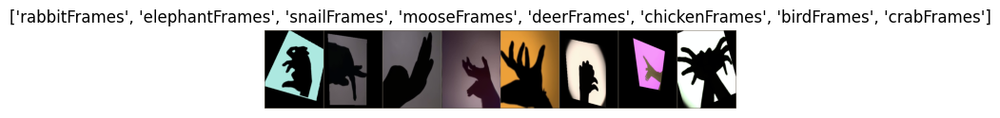

In [6]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    plt.axis('off')
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated


# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))
for i in inputs:
    print(i.shape)
# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title=[class_names[x] for x in classes])

In [ ]:
model = models.maxvit_t(pretrained=True)
loaded_model = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_MaxViT_1.pt')
# print(loaded_model.keys())
model.load_state_dict(loaded_model, strict=False)
model.eval().to(device)

In [ ]:
model = models.convnext_large(pretrained=True)
loaded_model = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_ConvNextLarge.pt')
# print(loaded_model.keys())
model.load_state_dict(loaded_model, strict=False)
model.eval().to(device)

In [6]:
def visualize_modelMaxViT(model, num_images=6):
    was_training = model.training
    model.eval().to(device)
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = F.interpolate(inputs, size=(224,224), antialias=True, mode='bilinear')
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('ground truth: {}, predicted: {}'.format(class_names[labels[j]], class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

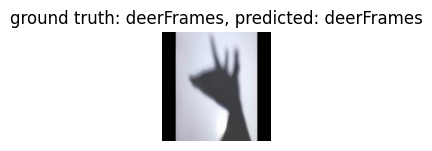

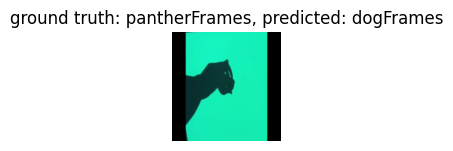

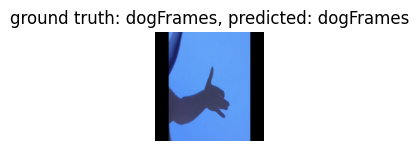

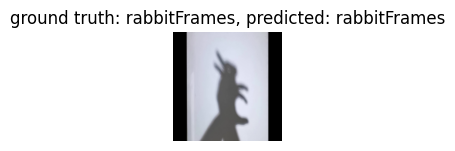

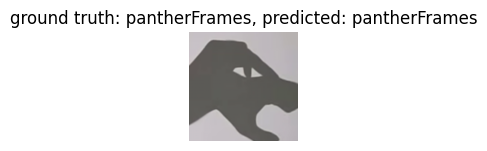

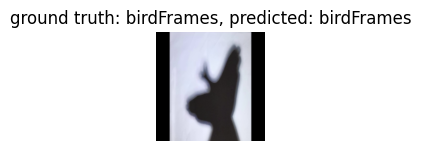

In [7]:
visualize_modelMaxViT(model)

In [2]:
def get_representations(model, iterator):

    model.eval()

    outputsList = []
    intermediatesList = []
    labelsList = []

    with torch.no_grad():
        
        for i, (inputs, labels) in enumerate(iterator):

            inputs = F.interpolate(inputs, size=(224,224), antialias=True, mode='bilinear')
            inputs = inputs.to(device)
            labels = labels.to(device)
#             print(model(inputs))
            outputs = model(inputs)
#             _, preds = torch.max(outputs, 1)

            outputsList.append(outputs.cpu())
            labelsList.append(labels.cpu())
        
    outputsList = torch.cat(outputsList, dim = 0)
    labelsList = torch.cat(labelsList, dim = 0)

    return outputsList, labelsList

In [63]:
def plot_representations(data, labels, classes, n_images = None, file_name="test.pdf"):
            
    if n_images is not None:
        data = data[:n_images]
        labels = labels[:n_images]
    plt.rcParams["font.size"] = 14
    fig = plt.figure(figsize = (15, 15))
    ax = fig.add_subplot(111)
#     for i in range(len(classes)):
#         for j in range (len(labels)):
#             if labels[j] == i:
#                 ax.scatter(data[j, 0], data[j, 1], c = labels[j], label = classes[labels[j]], cmap = 'hsv')
    scatter = ax.scatter(data[:, 0], data[:, 1], c = labels, cmap = 'hsv')
    handles, _ = scatter.legend_elements(prop='colors')
    legend = ax.legend(handles, classes, loc="upper right", title="Class Labels",fontsize=14,ncol=2)
    # ax.legend(ncol=2)
    fig.savefig(file_name, format="pdf", bbox_inches="tight")
    #     ax.legend()
#     plt.show()

In [4]:
def get_tsne(data, n_components = 2, n_images = None):
    
    if n_images is not None:
        data = data[:n_images]
        
    tsne = manifold.TSNE(n_components = n_components, random_state = 0)
    tsne_data = tsne.fit_transform(data)
    return tsne_data

In [5]:
outputsList, labelsList = get_representations(model, dataloaders['train'])

NameError: name 'model' is not defined

In [10]:
outputsList, labelsList = get_representations(model, dataloaders['train'])

In [14]:
# print(outputsList, len(outputsList))
# print(labelsList, len(labelsList))
# print(output_tsne_data)
print(max(labelsList))

tensor(10)


In [76]:
output_tsne_data = get_tsne(outputsList)

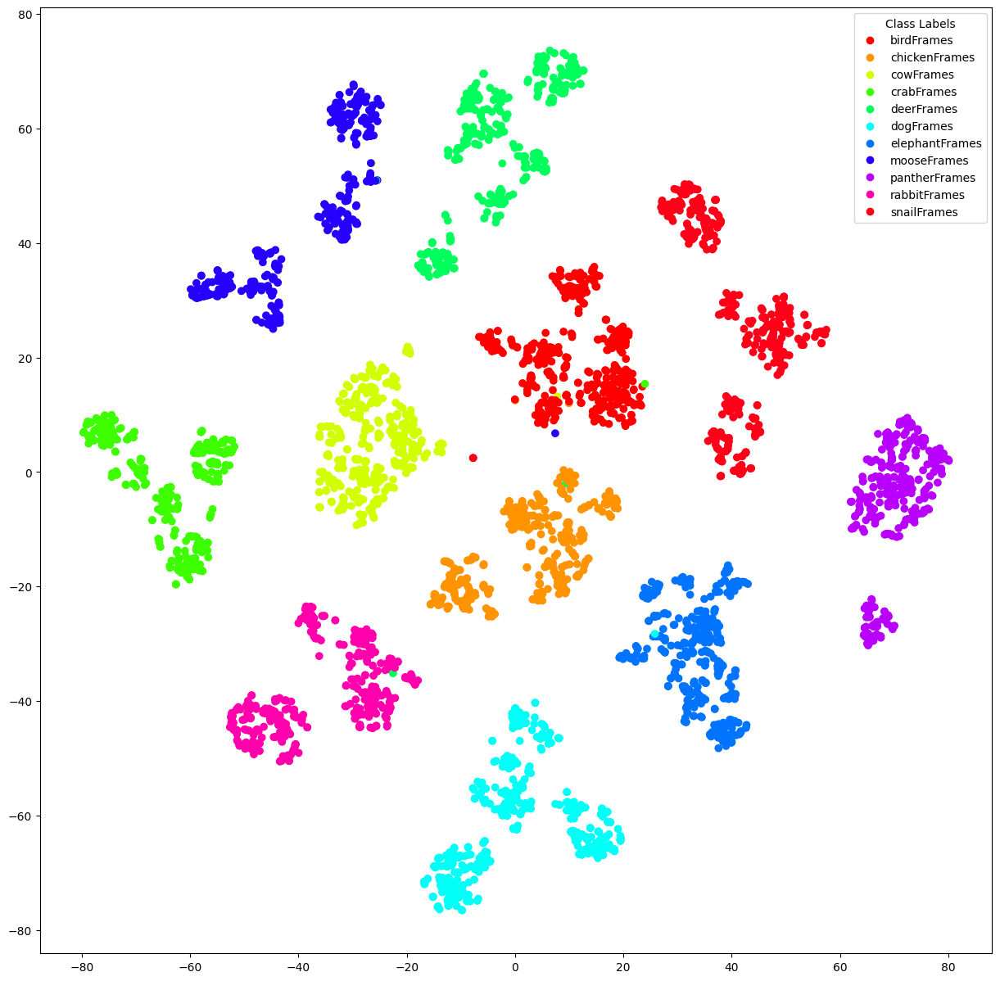

In [88]:
plot_representations(output_tsne_data, labelsList, class_names)

In [7]:
def get_pca(data, n_components = 2):
    pca = decomposition.PCA()
    pca.n_components = n_components
    pca_data = pca.fit_transform(data)
    return pca_data

In [89]:
output_pca_data = get_pca(outputsList)

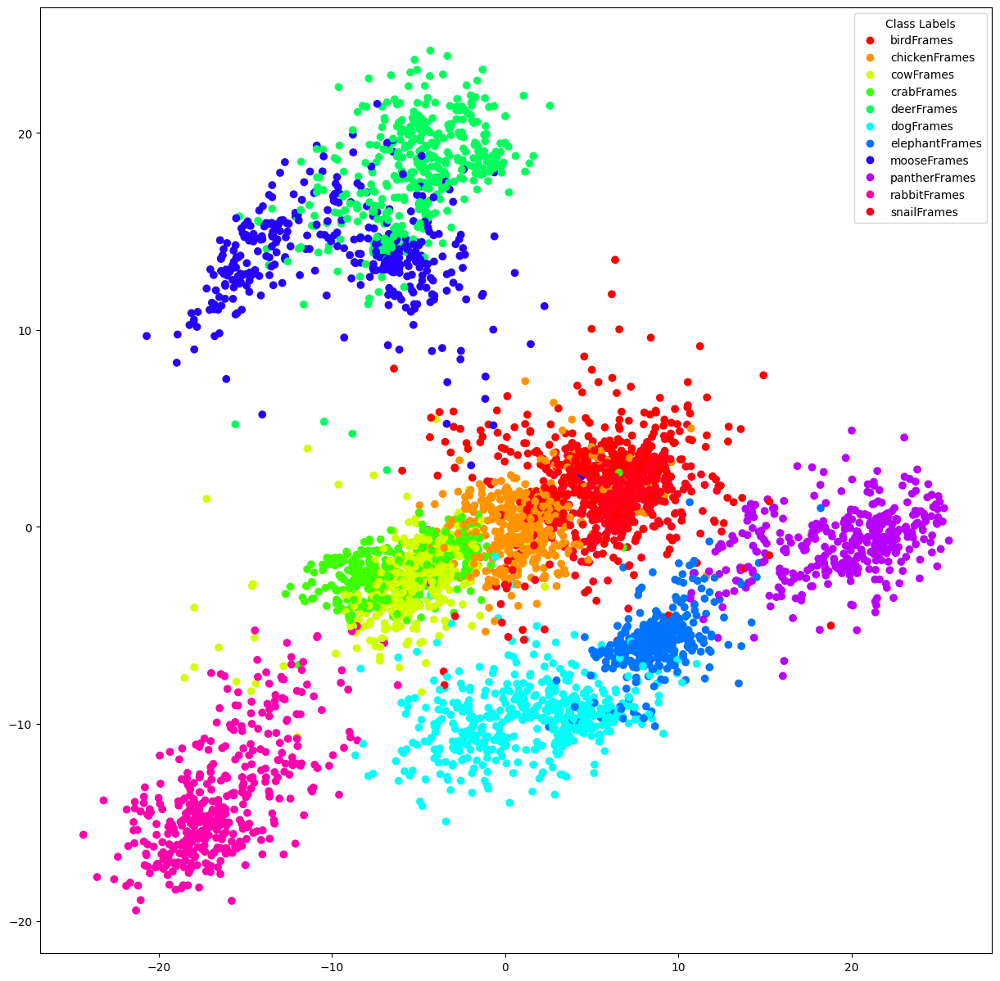

In [90]:
plot_representations(output_pca_data, labelsList, class_names)

In [12]:
model1 = models.densenet121(pretrained=True)
loaded_model1 = torch.load('/home/cse/Rifat/HaSPeR/saved_models/HSPR_DenseNet121.pt')
# print(loaded_model.keys())
model1.load_state_dict(loaded_model1, strict=False)
model1.eval().to(device)

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.


DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [57]:
outputsList1, labelsList1 = get_representations(model1, dataloaders['train'])

In [91]:
output_tsne_data1 = get_tsne(outputsList1)

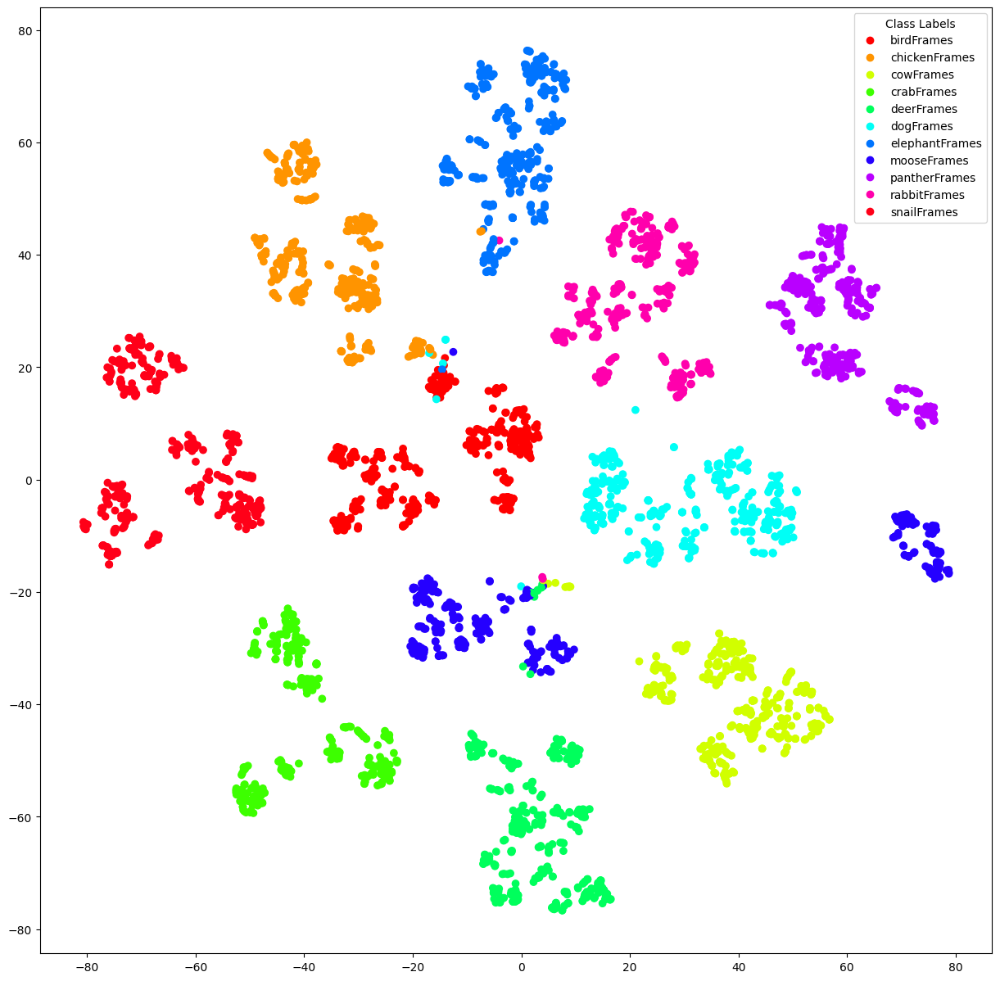

In [92]:
plot_representations(output_tsne_data1, labelsList1, class_names)

In [93]:
output_pca_data1 = get_pca(outputsList1)

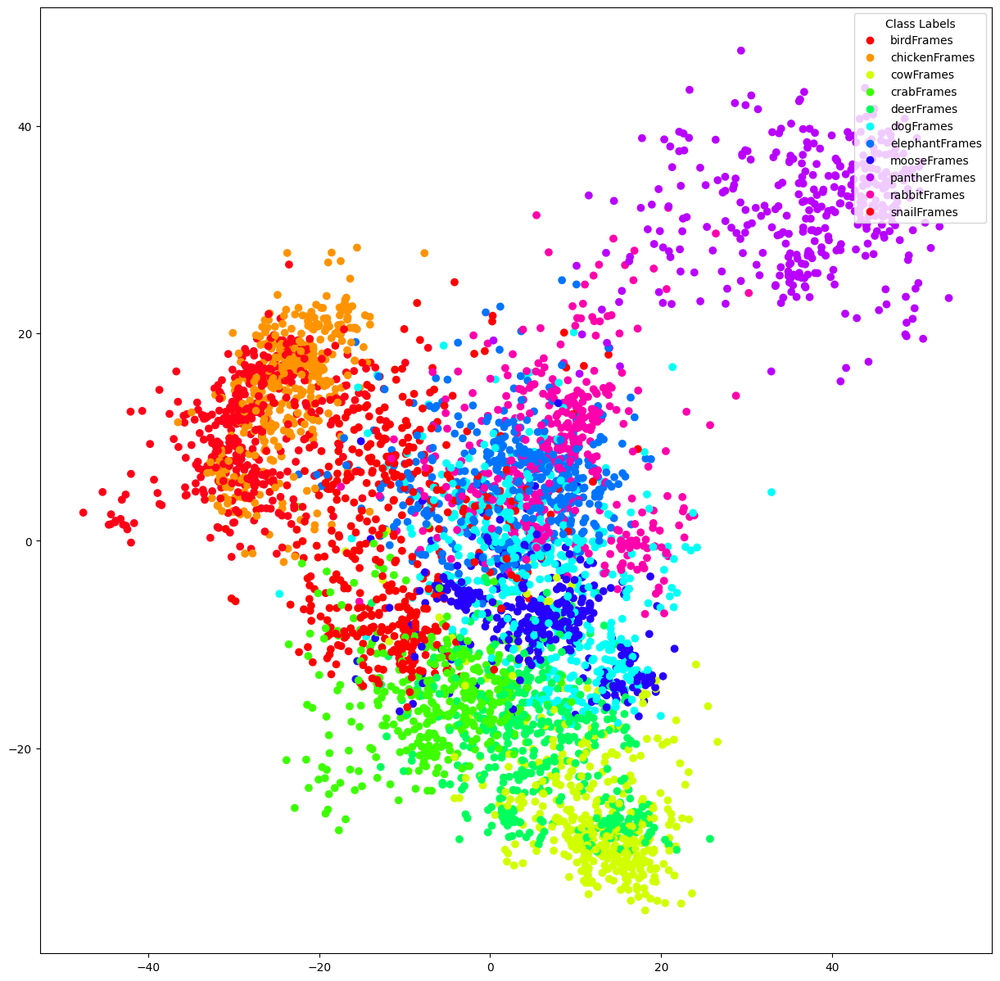

In [94]:
plot_representations(output_pca_data1, labelsList1, class_names)

In [54]:
outputsList_best, labelsList_best = get_representations(model_best, dataloaders['train'])

In [55]:
output_tsne_data_best = get_tsne(outputsList_best)

/home/cse/.local/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/cse/.local/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


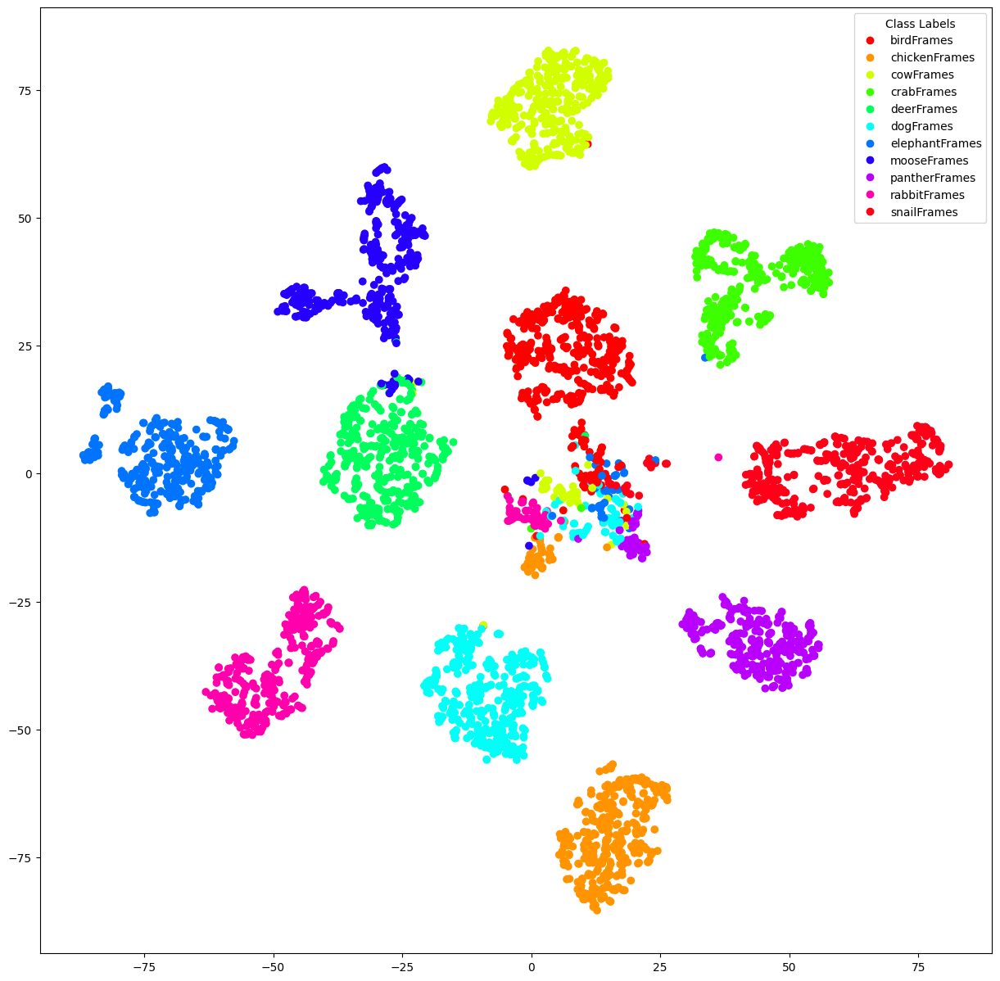

In [60]:
plot_representations(output_tsne_data_best, labelsList_best, class_names)

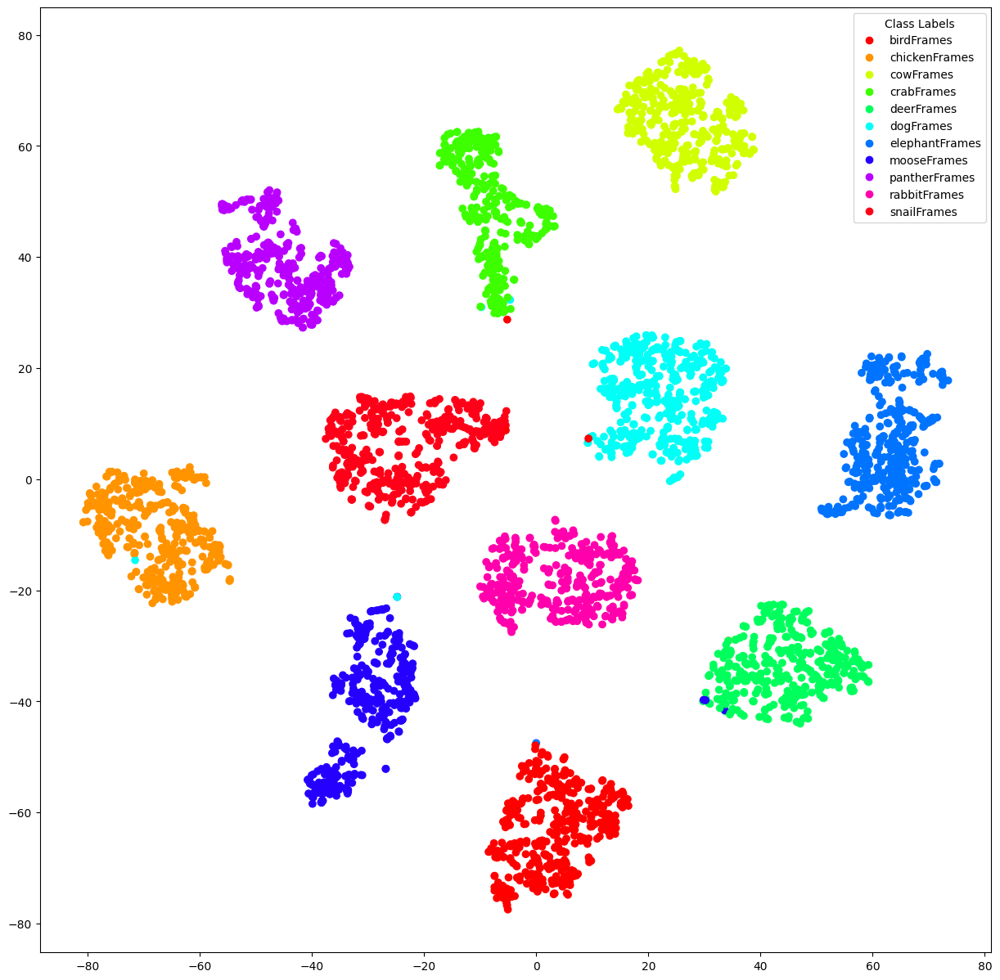

In [11]:
plot_representations(output_tsne_data_best, labelsList_best, class_names)

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

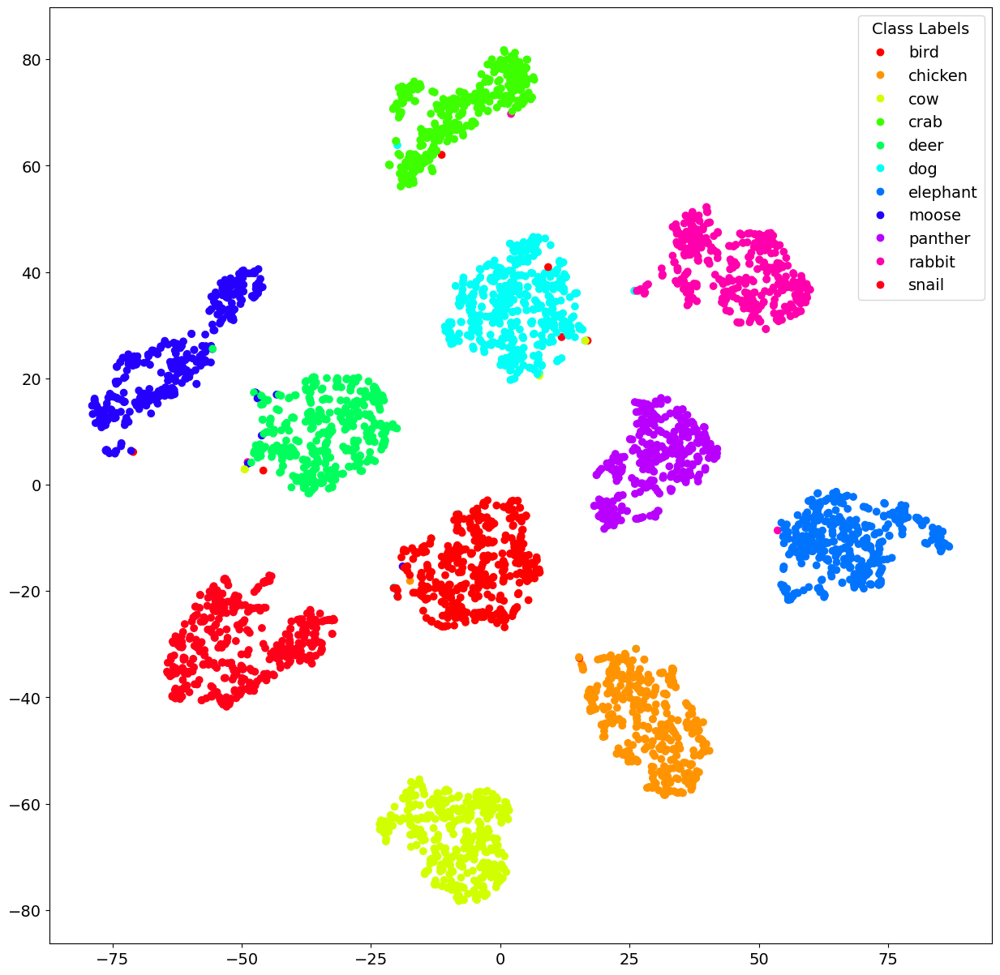

In [48]:
plot_representations(output_tsne_data_best, labelsList_best, [animal[:-6] for animal in class_names], file_name="best_tsne.pdf")

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

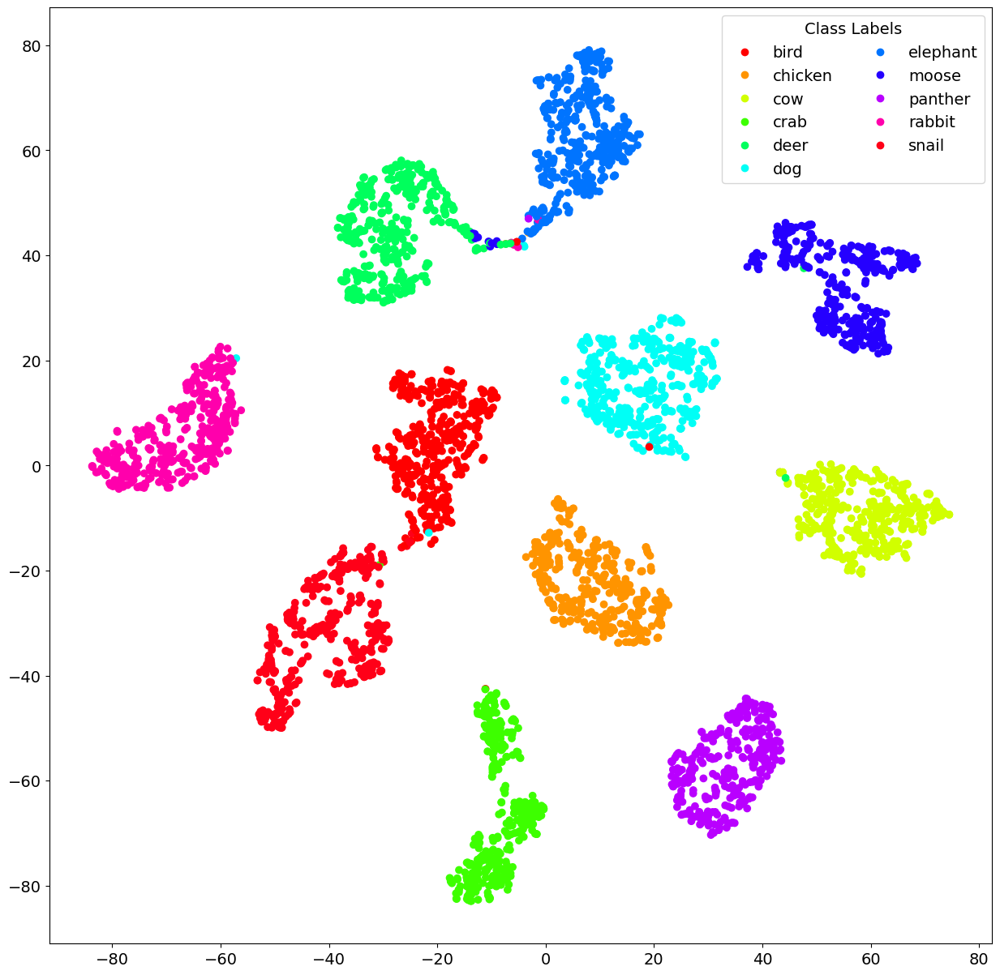

In [64]:
plot_representations(output_tsne_data_best, labelsList_best, [animal[:-6] for animal in class_names], file_name="best_CB_tsne.pdf")

In [65]:
output_pca_data_best = get_pca(outputsList_best)

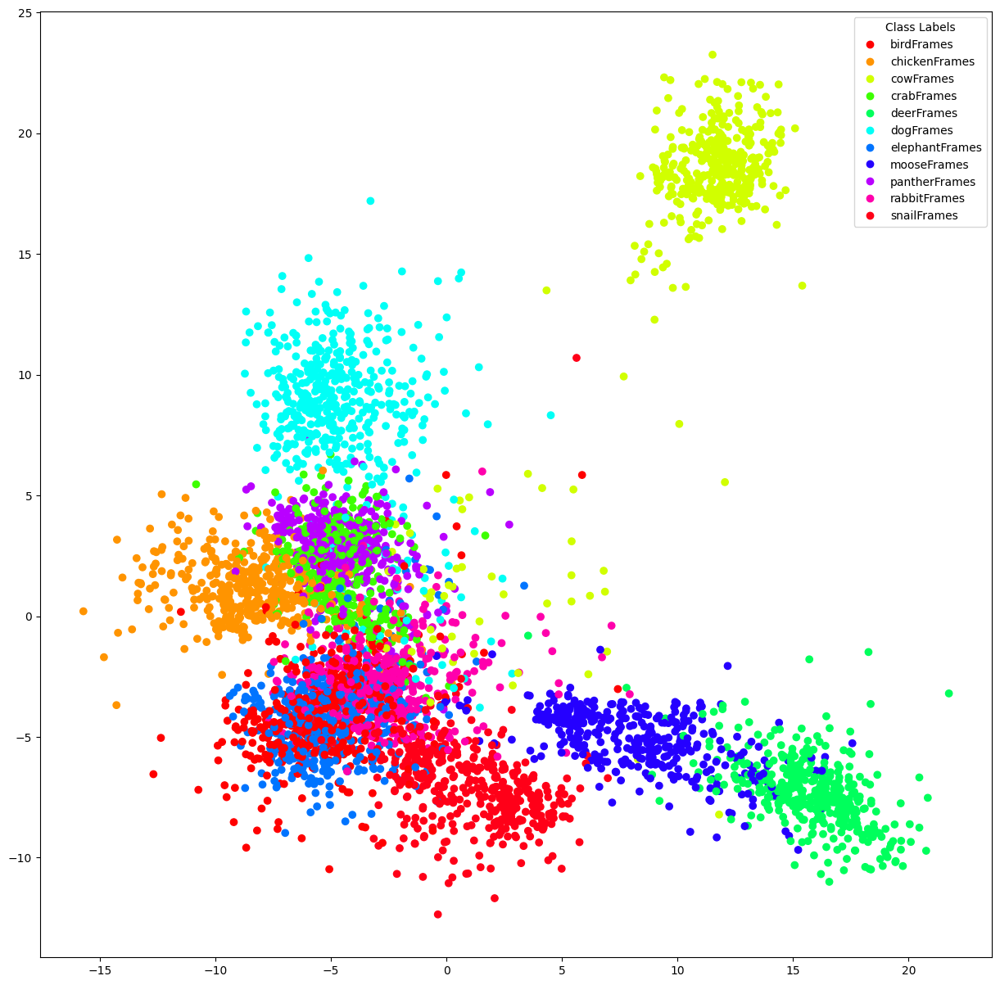

In [64]:
plot_representations(output_pca_data_best, labelsList_best, class_names)

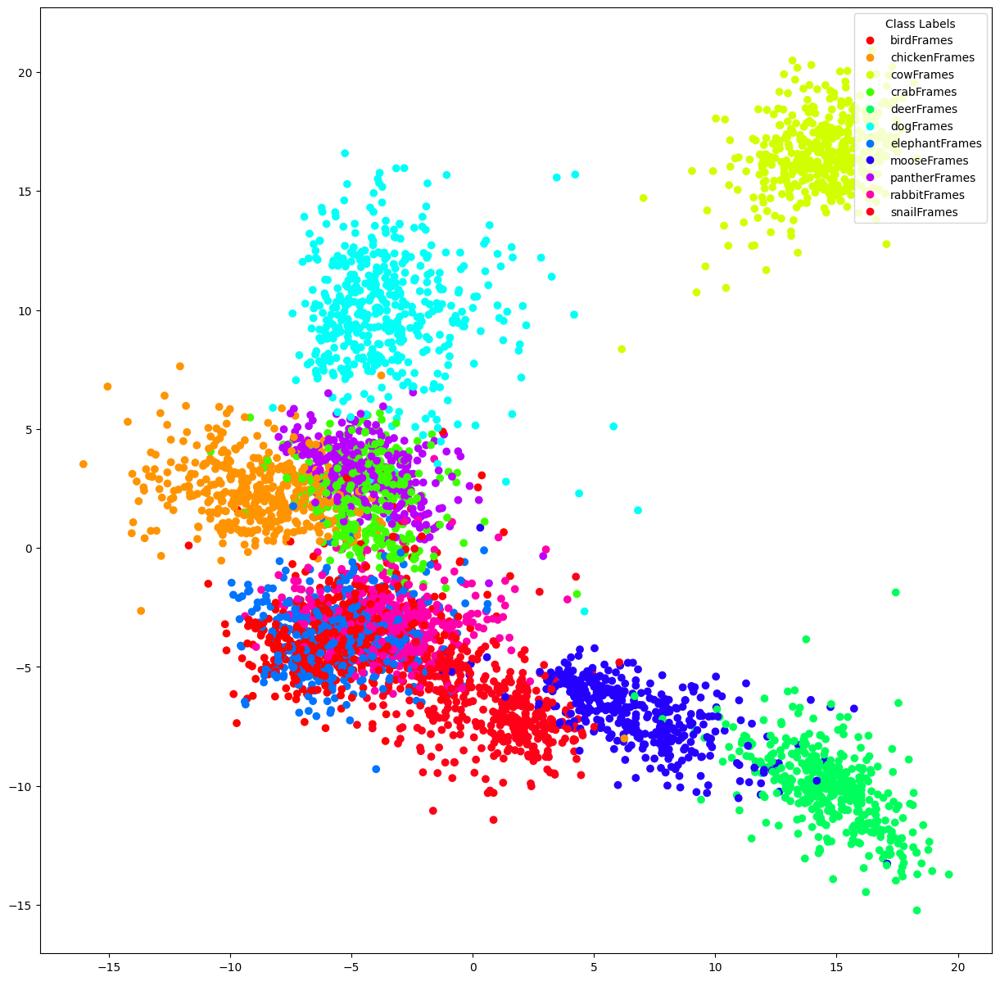

In [13]:
plot_representations(output_pca_data_best, labelsList_best, class_names)

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

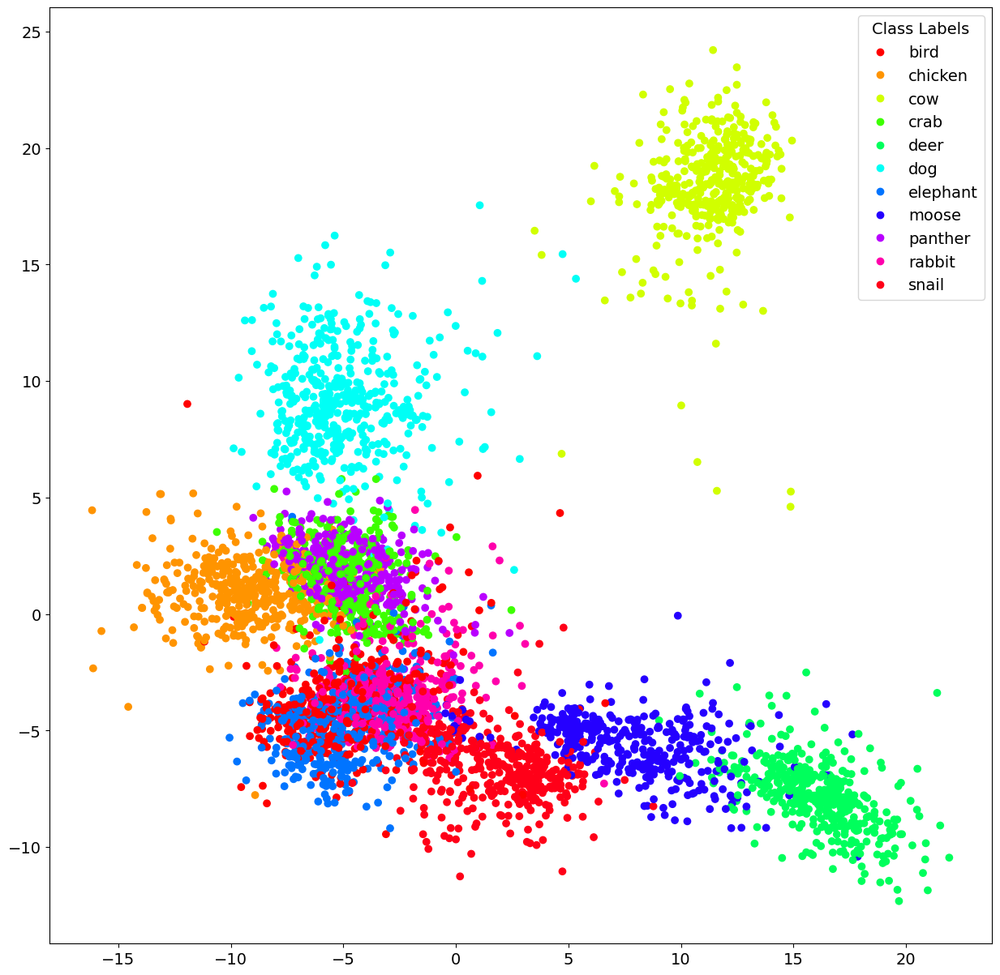

In [50]:
plot_representations(output_pca_data_best, labelsList_best, [animal[:-6] for animal in class_names], file_name="best_pca.pdf")

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

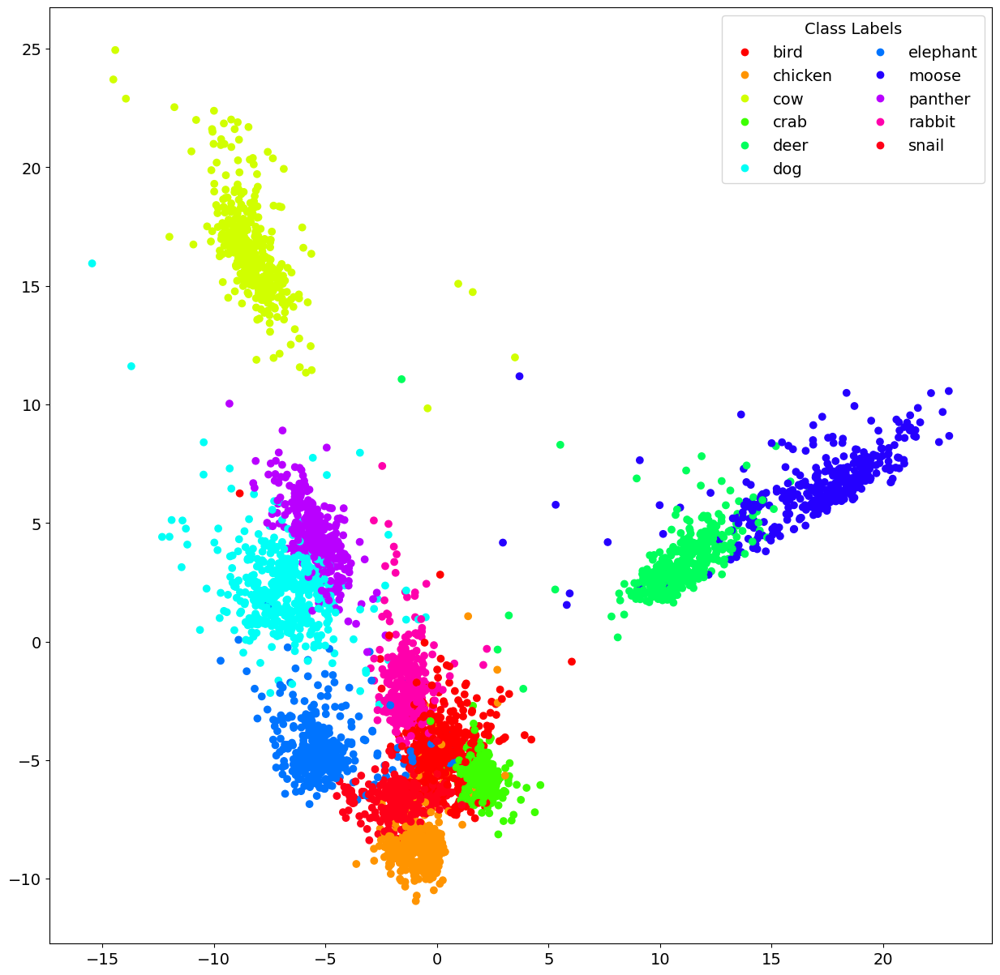

In [66]:
plot_representations(output_pca_data_best, labelsList_best, [animal[:-6] for animal in class_names], file_name="best_CB_pca.pdf")

/home/cse/.local/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/cse/.local/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font 

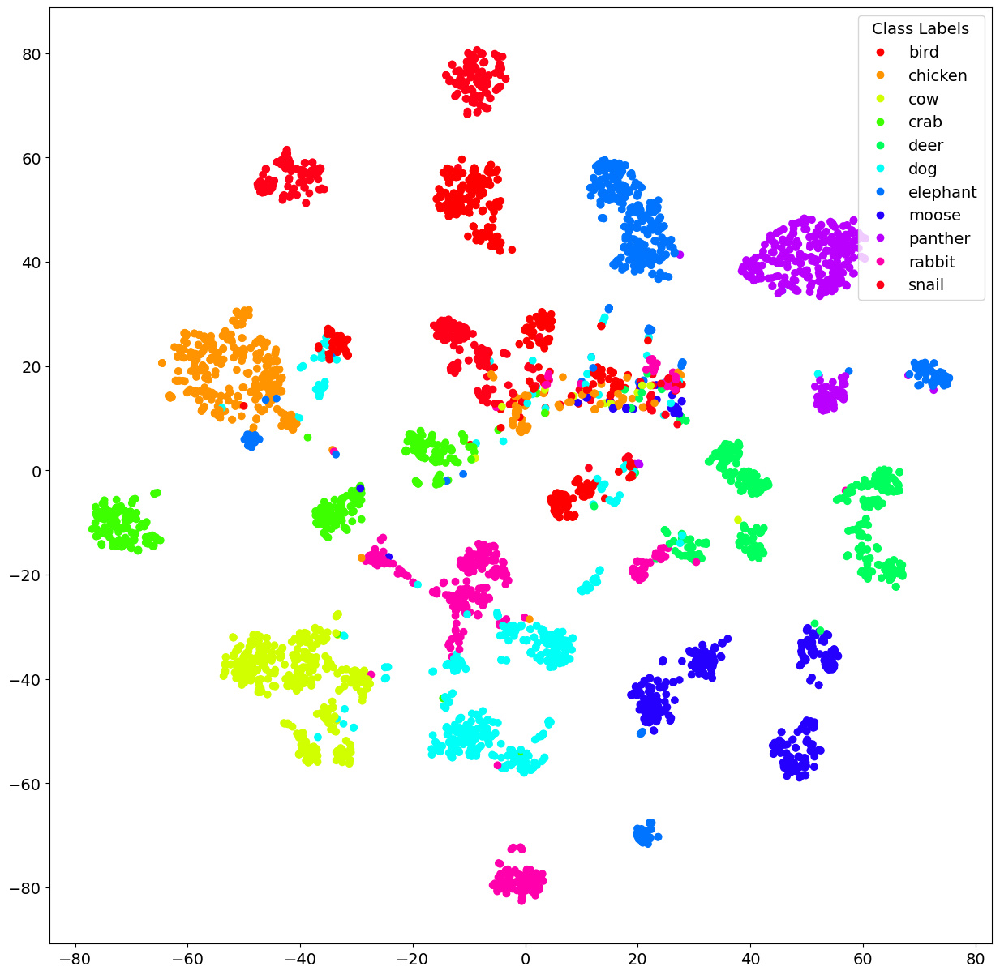

In [51]:
outputsList_worst, labelsList_worst = get_representations(model_worst, dataloaders['train'])
output_tsne_data_worst = get_tsne(outputsList_worst)
plot_representations(output_tsne_data_worst, labelsList_worst, [animal[:-6] for animal in class_names],file_name="worst_tsne.pdf")

/home/cse/.local/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/cse/.local/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font 

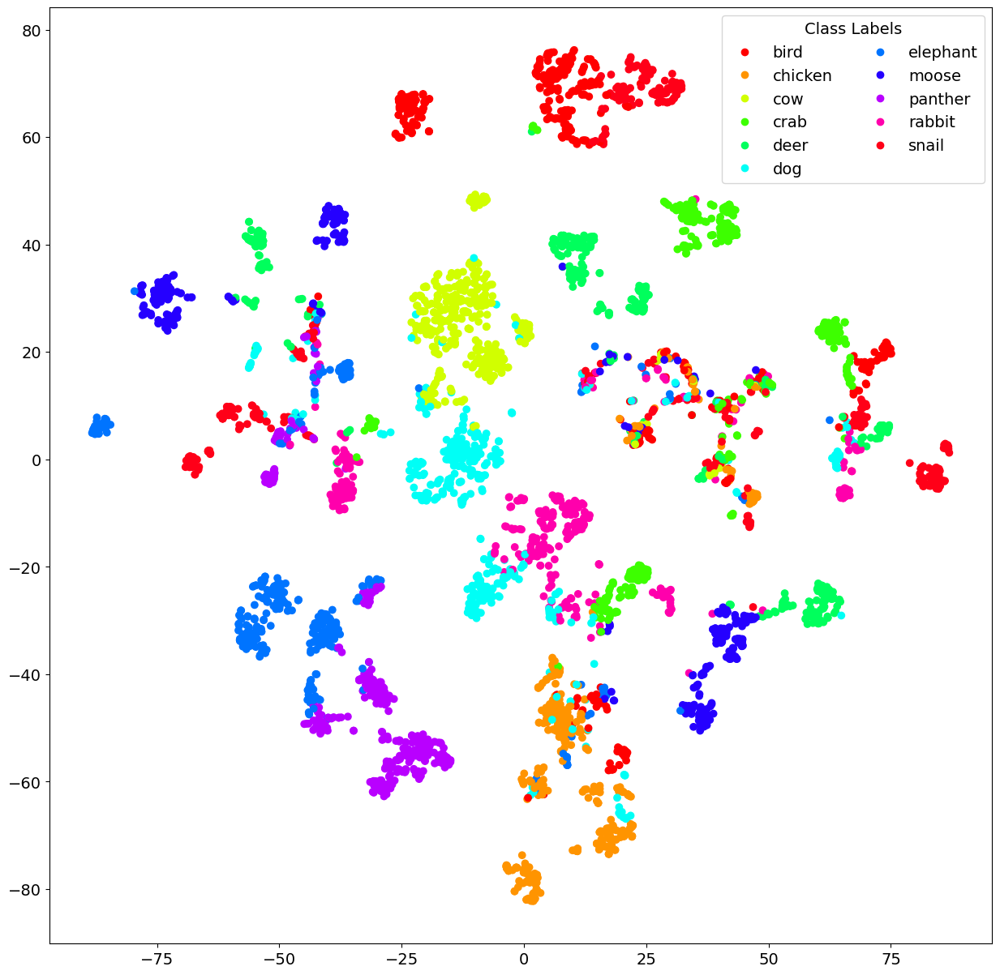

In [69]:
outputsList_worst, labelsList_worst = get_representations(model_worst, dataloaders['train'])
output_tsne_data_worst = get_tsne(outputsList_worst)
plot_representations(output_tsne_data_worst, labelsList_worst, [animal[:-6] for animal in class_names],file_name="worst_CB_tsne.pdf")

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

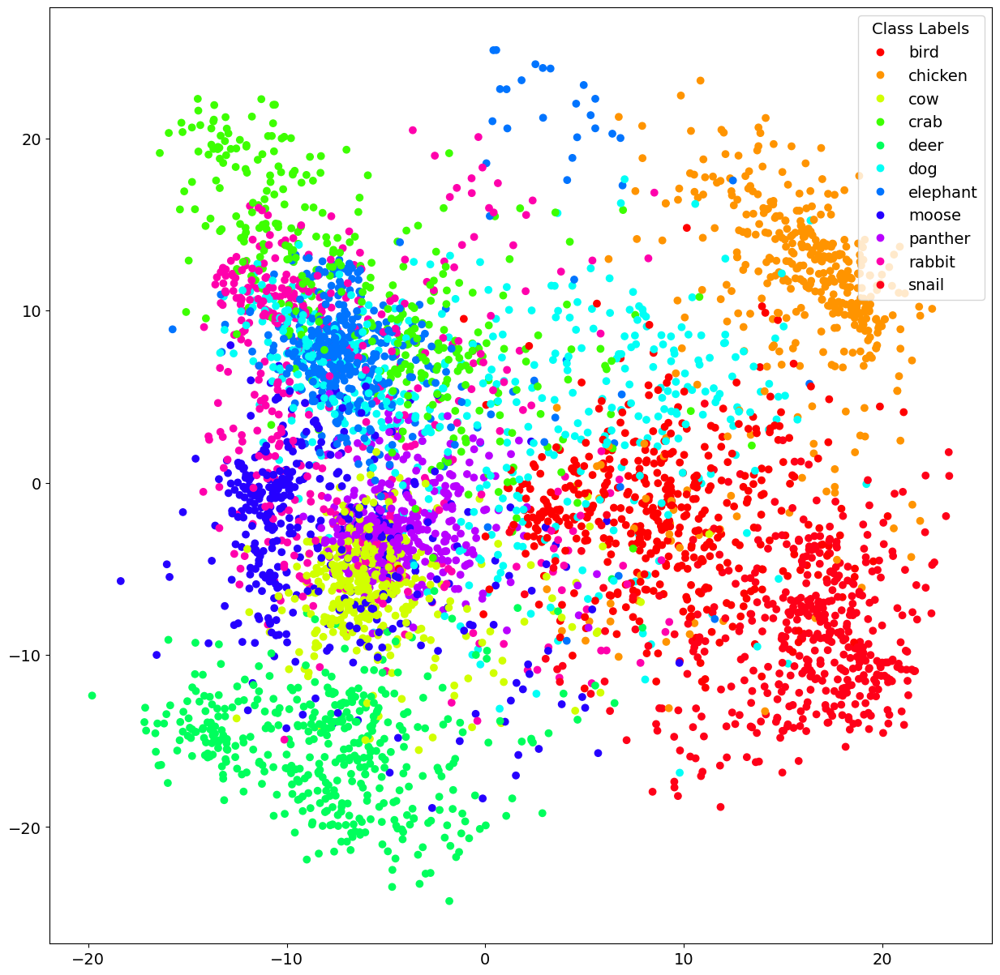

In [52]:
output_pca_data_worst = get_pca(outputsList_worst)
plot_representations(output_pca_data_worst, labelsList_worst, [animal[:-6] for animal in class_names],file_name="worst_pca.pdf")

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

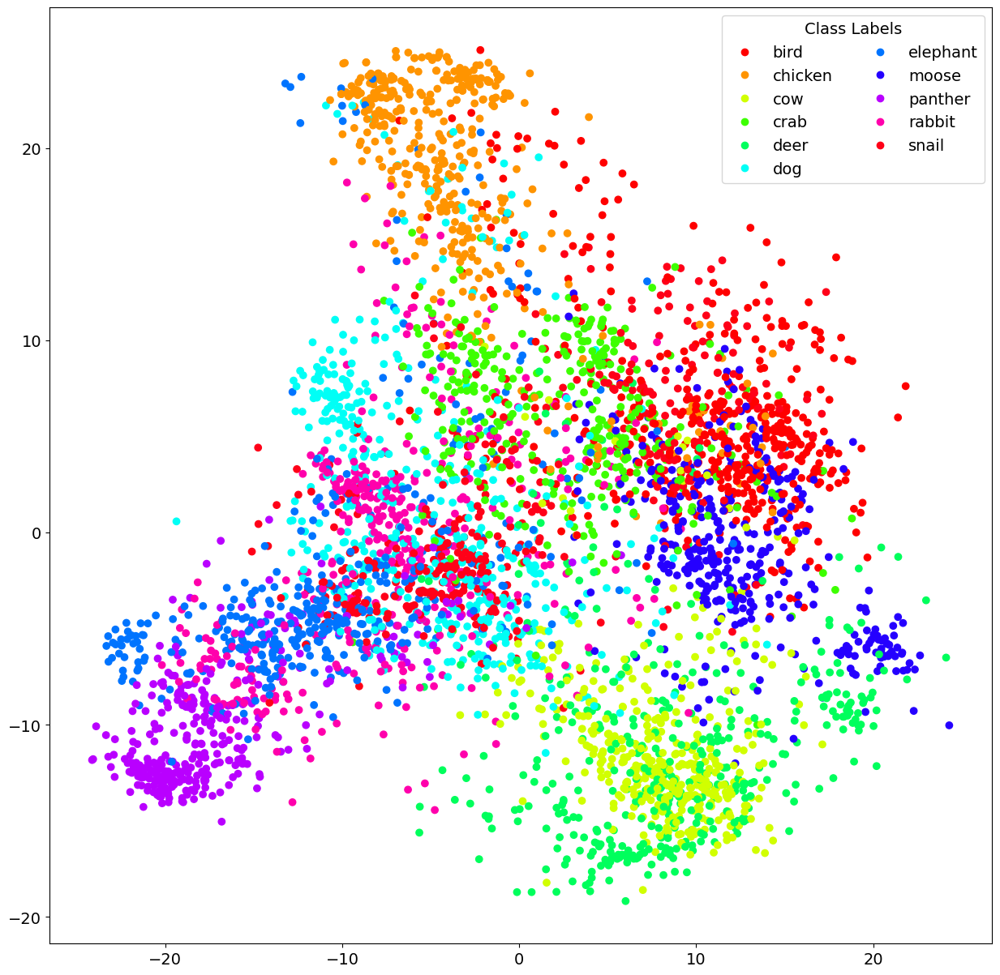

In [70]:
output_pca_data_worst = get_pca(outputsList_worst)
plot_representations(output_pca_data_worst, labelsList_worst, [animal[:-6] for animal in class_names],file_name="worst_CB_pca.pdf")

In [ ]:
! pip install timm-vis timm

In [5]:
from timm_vis.methods import *
import timm

In [6]:
from PIL import Image
import cv2

In [93]:
test_image = Image.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image5.png').resize((1920,1080),2).convert('RGB')
print(test_image.size)
test_image.save('/home/cse/Rifat/HaSPeR/latest/data2/val/image51.png','PNG')

(1920, 1080)


In [ ]:
print(model1)

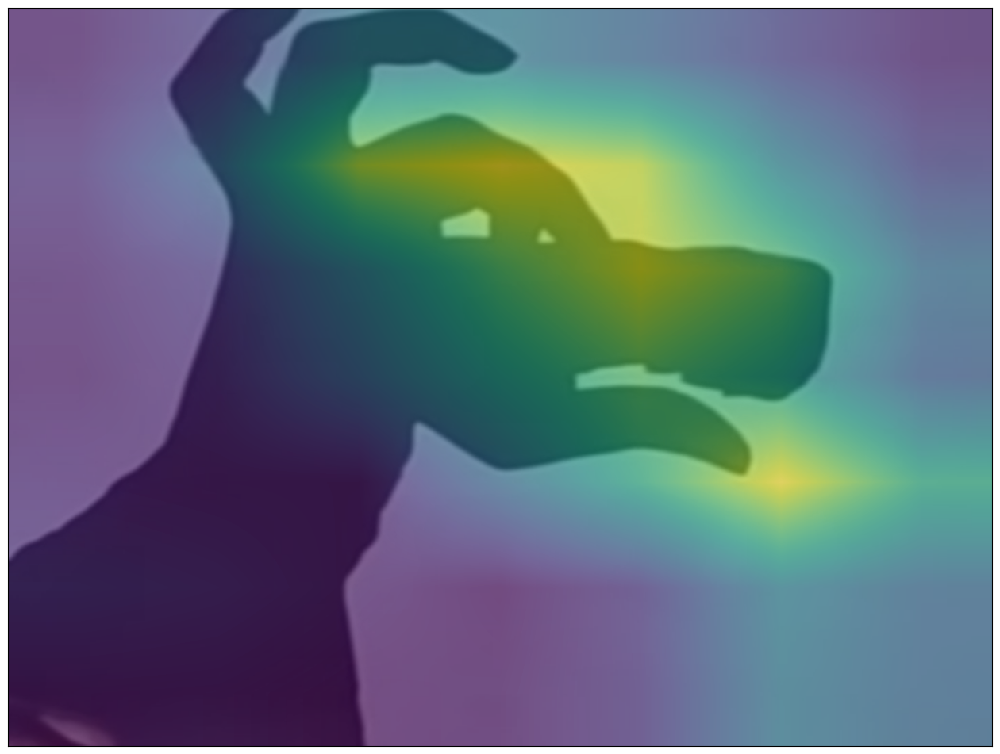

In [124]:
grad_cam(model1, [model1.features.denseblock4.denselayer32.conv1, model1.features.denseblock4.denselayer32.conv2], '/home/cse/Rifat/HaSPeR/latest/data2/val/dogFrames/dog_369.PNG', 5)

In [68]:
model_worst = models.vit_b_16(pretrained=True)
num_ftrs_worst = model_worst.heads.head.in_features
#--------------------------------------------------
# Classifier Block
classifier_block = nn.Sequential(
                                    nn.Linear(num_ftrs_worst, 512),
                                    nn.BatchNorm1d(512),
                                    nn.ReLU(inplace=True),
                                    nn.Dropout(0.5),
                                    nn.Linear(512, 256),
                                    nn.BatchNorm1d(256),
                                    nn.ReLU(inplace=True),
                                    nn.Dropout(0.5),
                                    nn.Linear(256, 11))
#--------------------------------------------------
# model_worst.fc = nn.Linear(num_ftrs_worst, 11)
model_worst.fc = classifier_block
loaded_model_worst = torch.load('/home/cse/Rifat/HaSPeR/saved_models/HSPR_ViTB16_Aug_CB.pt')
# print(loaded_model.keys())
model_worst.load_state_dict(loaded_model_worst, strict=False)
asd = model_worst.eval().to(device)

/home/cse/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/cse/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ViT_B_16_Weights.IMAGENET1K_V1`. You can also use `weights=ViT_B_16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [53]:
model_best = models.inception_v3(pretrained=True)
num_ftrs_best = model_best.fc.in_features
#--------------------------------------------------
# Classifier Block
classifier_block = nn.Sequential(
                                    nn.Linear(num_ftrs_best, 512),
                                    nn.BatchNorm1d(512),
                                    nn.ReLU(inplace=True),
                                    nn.Dropout(0.5),
                                    nn.Linear(512, 256),
                                    nn.BatchNorm1d(256),
                                    nn.ReLU(inplace=True),
                                    nn.Dropout(0.5),
                                    nn.Linear(256, 11))
#--------------------------------------------------
# model_best.fc = nn.Linear(num_ftrs_best, 11)
model_best.fc = classifier_block
loaded_model_best = torch.load('/home/cse/Rifat/HaSPeR/saved_models/HSPR_InceptionV3_Aug_CB.pt')
# print(loaded_model.keys())
model_best.load_state_dict(loaded_model_best, strict=False)
asd = model_best.eval().to(device)

/home/cse/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/cse/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


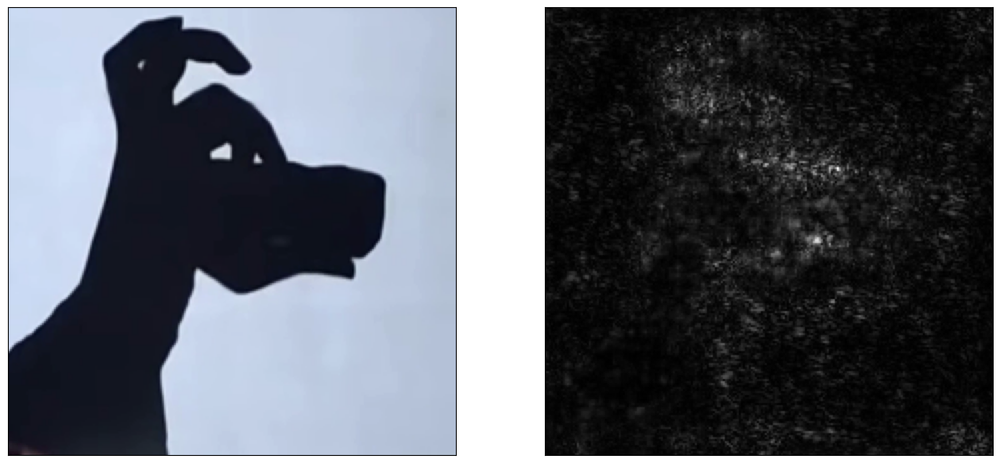

In [59]:
saliency_map(model1, '/home/cse/Rifat/HaSPeR/latest/data2/val/dogFrames/dog_355.PNG')

The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).


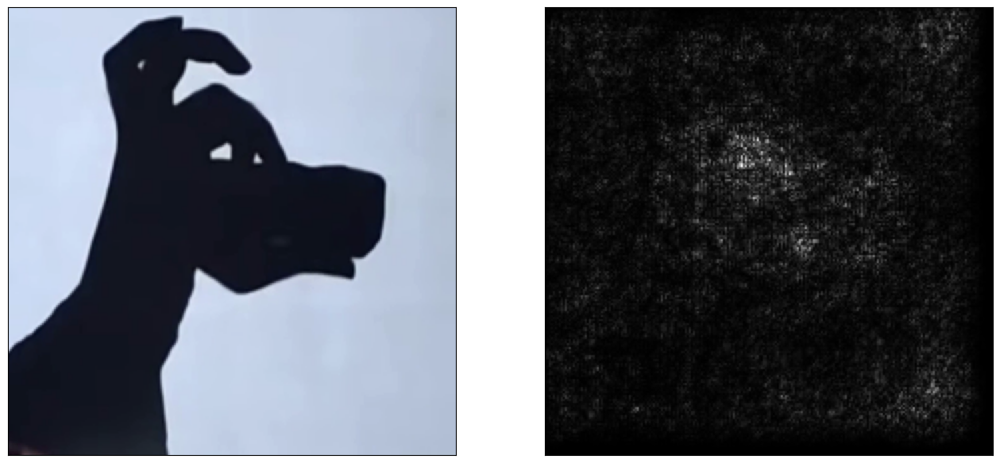

In [11]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/dogFrames/dog_355.PNG')

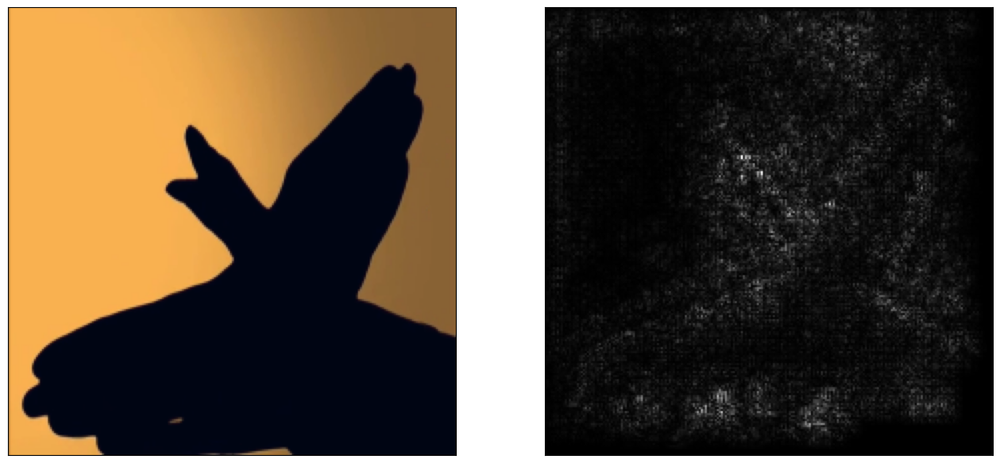

In [13]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/birdFrames/bird_19.PNG')

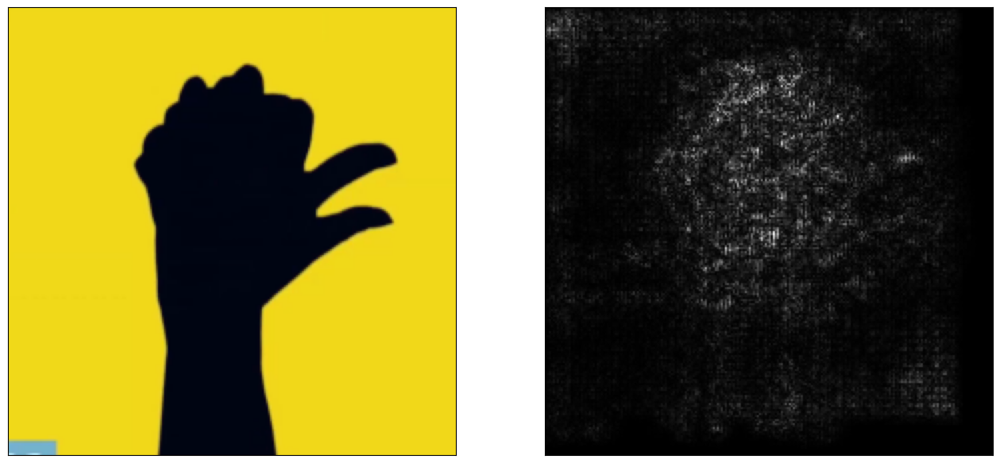

In [15]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/chickenFrames/chicken_471.PNG')

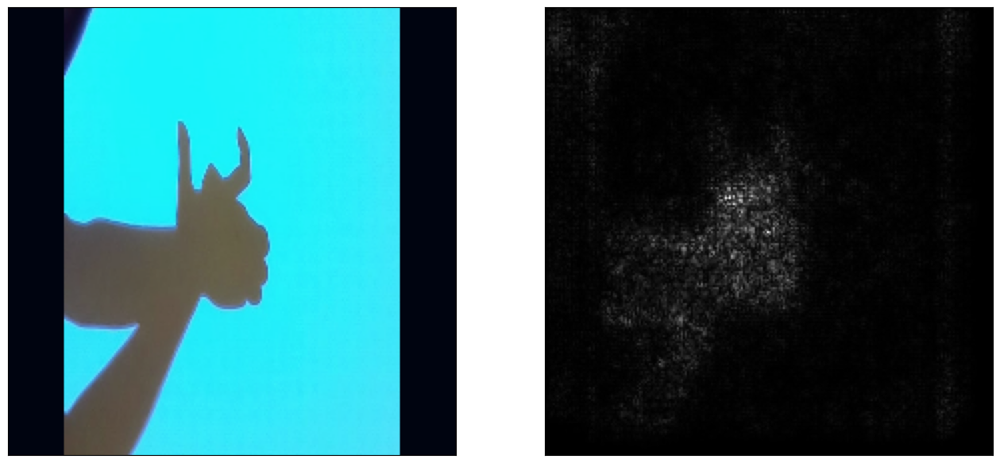

In [18]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/cowFrames/cow_547.PNG')

The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).


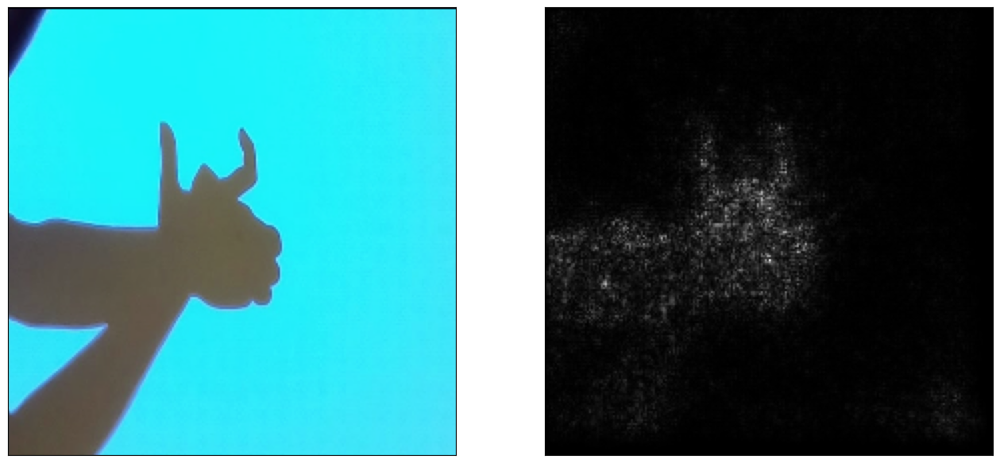

In [85]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/image21.png')

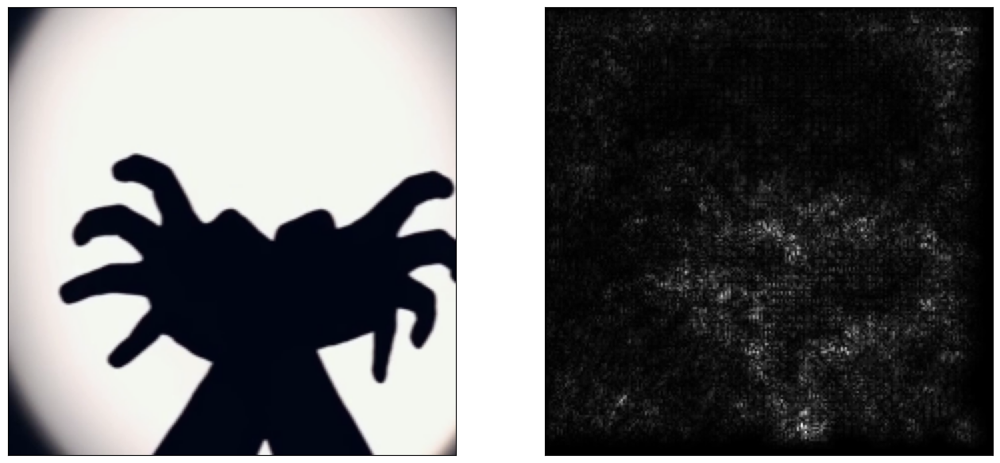

In [21]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/crabFrames/crab_261.PNG')

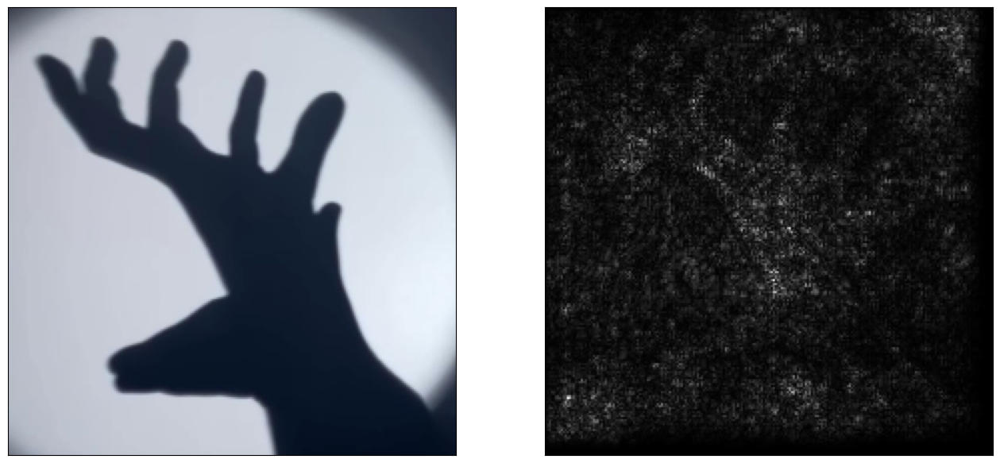

In [25]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/deerFrames/deer_352.PNG')

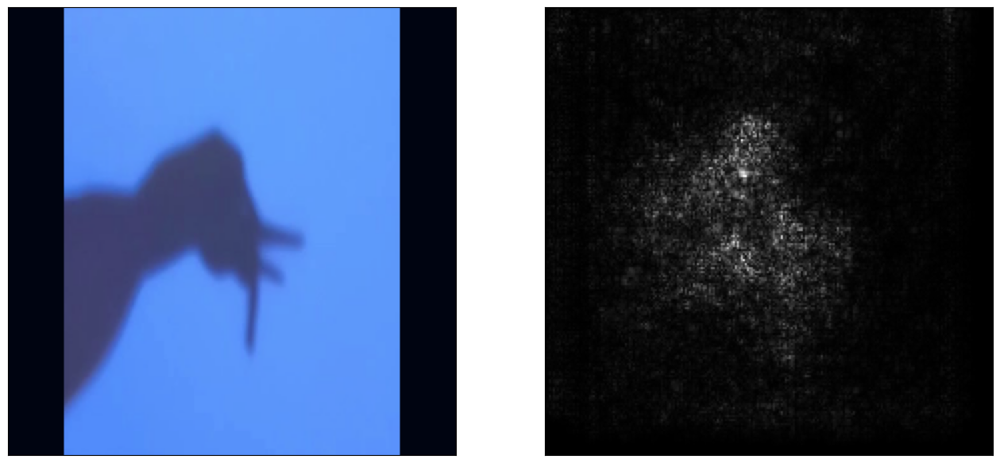

In [29]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/elephantFrames/elephant_504.PNG')

The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).


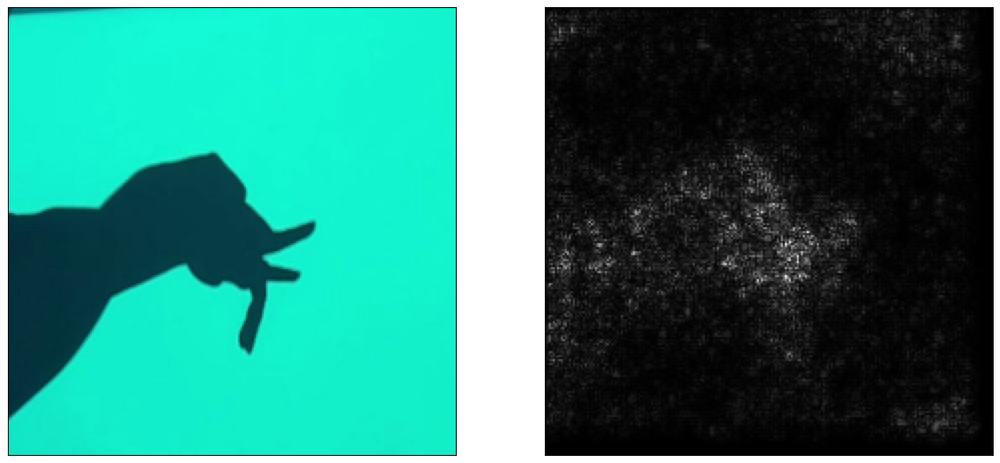

In [82]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/image1.png')

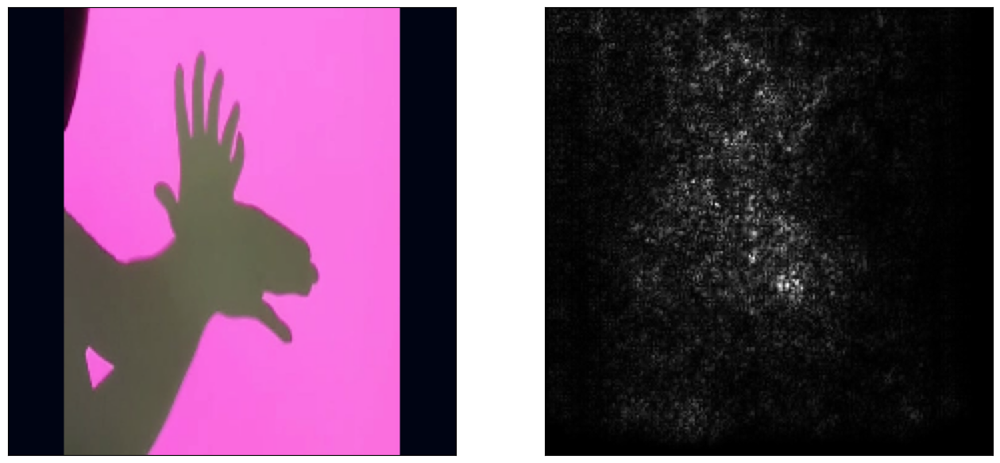

In [60]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/mooseFrames/moose_573.PNG')

The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).


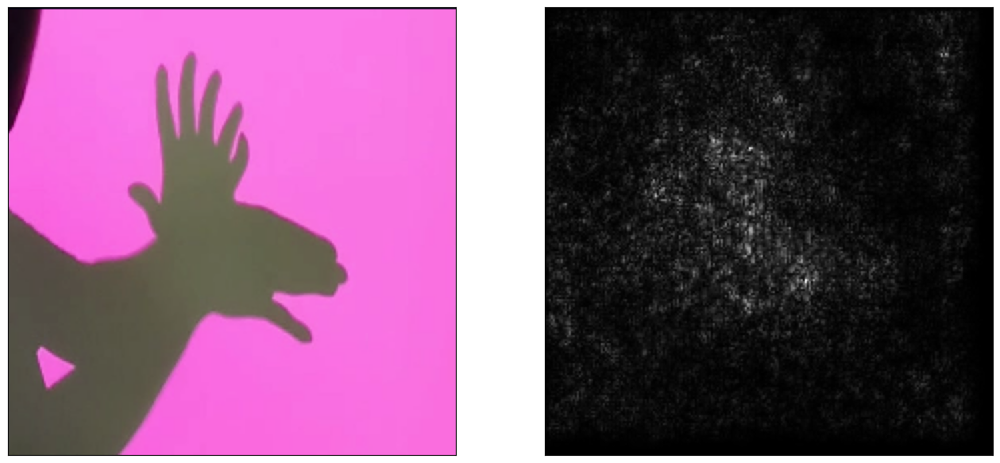

In [87]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/image31.png')

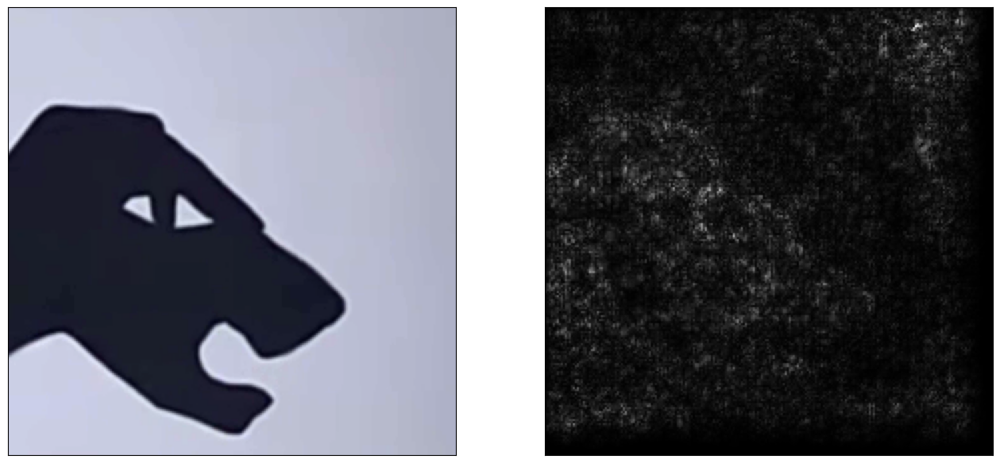

In [67]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/pantherFrames/panther_277.PNG')

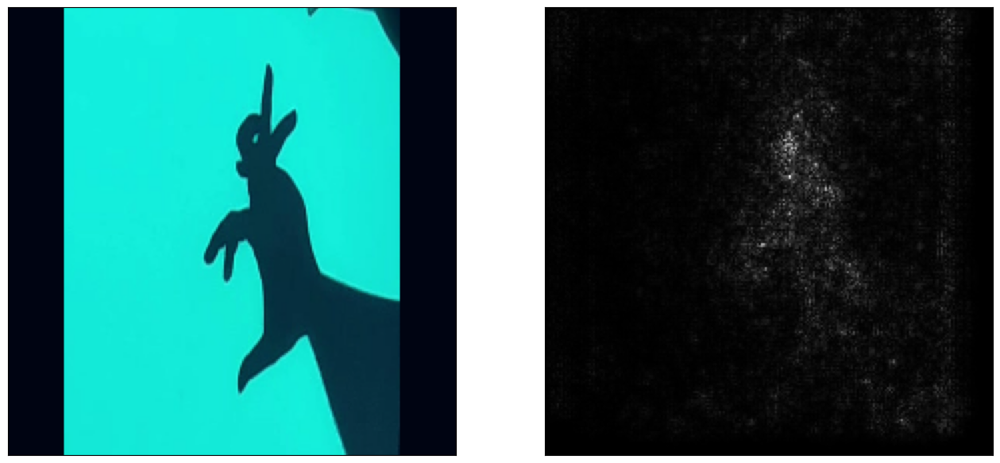

In [73]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/rabbitFrames/rabbit_557.PNG')

The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).


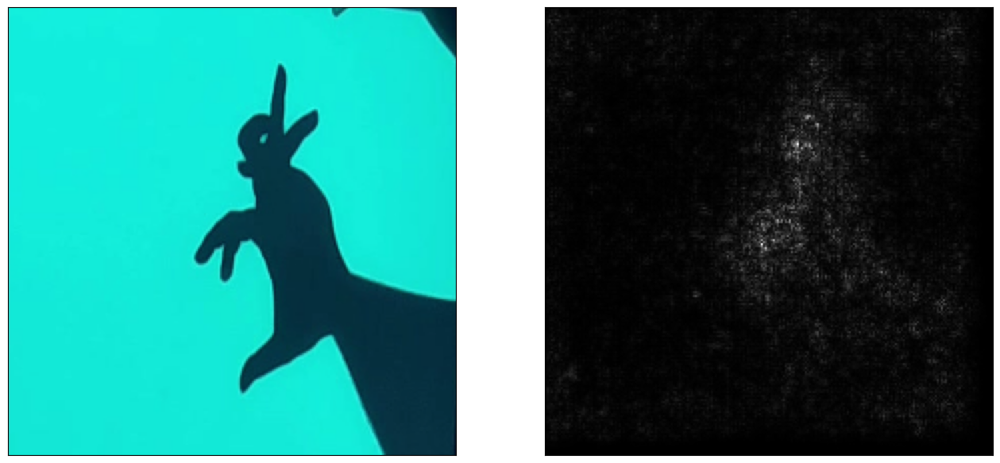

In [90]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/image41.png')

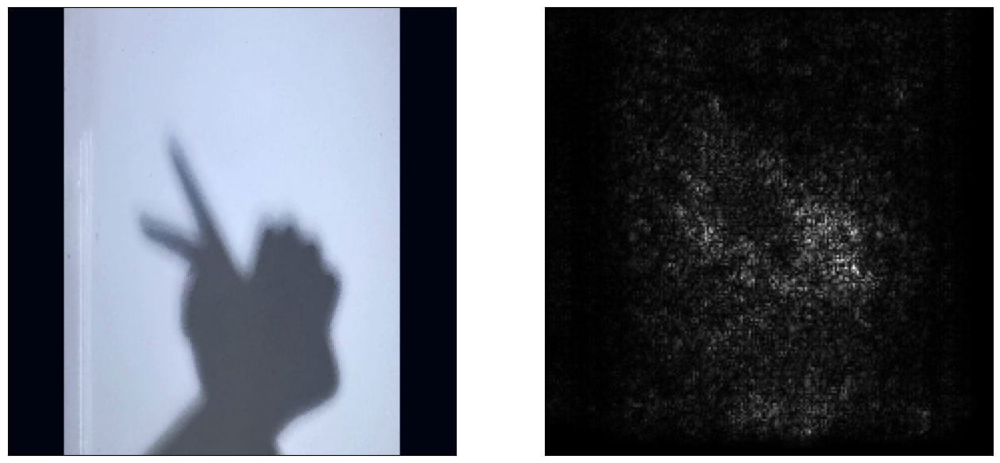

In [79]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/snailFrames/snail_686.PNG')

The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).


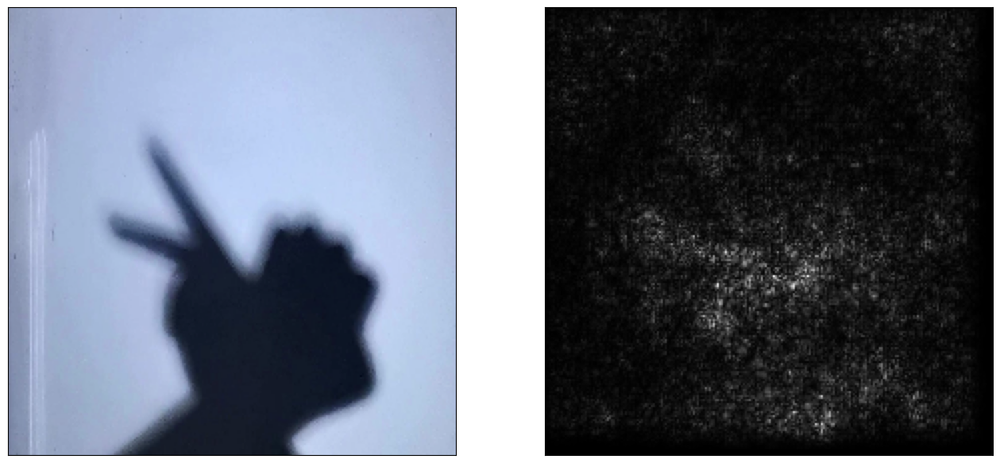

In [94]:
saliency_map(model_best, '/home/cse/Rifat/HaSPeR/latest/data2/val/image51.png')

In [ ]:
! pip install omnixai

In [ ]:
! pip install scikit-learn==1.1.3

In [8]:
from omnixai.data.image import Image
from omnixai.explainers.vision.specific.gradcam.pytorch.gradcam import GradCAM
from PIL import Image as PilImage
from omnixai.explainers.vision import LimeImage

In [100]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/dogFrames/dog_355.PNG').convert('RGB'))

In [10]:
print(model_best)

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [11]:
import matplotlib.pyplot as plt

In [ ]:
! pip install dash

[<Figure size 640x480 with 2 Axes>]

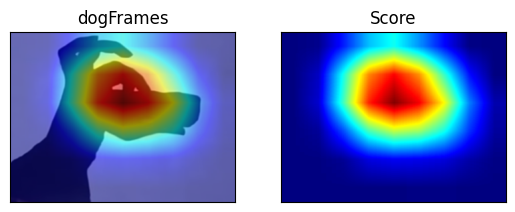

In [115]:
transform = transforms.Compose([
    transforms.Resize(256),
    # transforms.CenterCrop(224),
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
preprocess = lambda ims: torch.stack([transform(im.to_pil()) for im in ims])
explainer = GradCAM(
    model=model_best,
    target_layer=model_best.Mixed_7c,
    preprocess_function=preprocess
)
# Explain the top label
explanations = explainer.explain(img)
# plt.figure(figsize=(100,100))
# f.set_figwidth(400)
# f.set_figheight(400)
explanations.plot(index=0, class_names=class_names)

[<Figure size 640x480 with 2 Axes>]

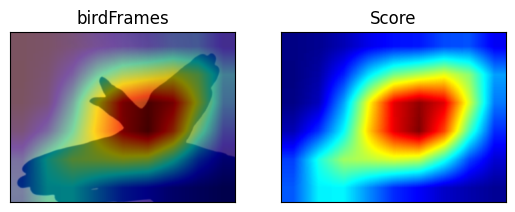

In [116]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/birdFrames/bird_19.PNG').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

[<Figure size 640x480 with 2 Axes>]

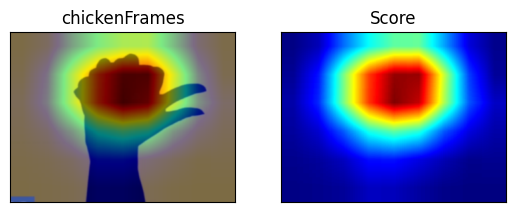

In [117]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/chickenFrames/chicken_471.PNG').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

[<Figure size 640x480 with 2 Axes>]

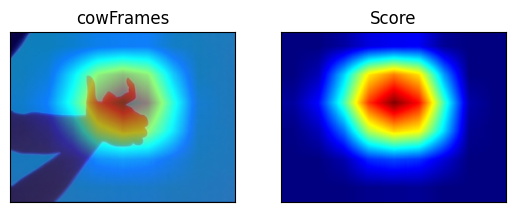

In [130]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image2.png').convert('RGB'))
explanations = explainer.explain(img, y=2)
explanations.plot(index=0, class_names=class_names)

[<Figure size 640x480 with 2 Axes>]

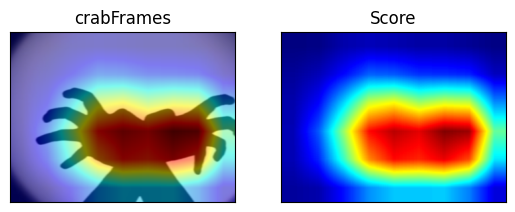

In [123]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/crabFrames/crab_261.PNG').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

[<Figure size 640x480 with 2 Axes>]

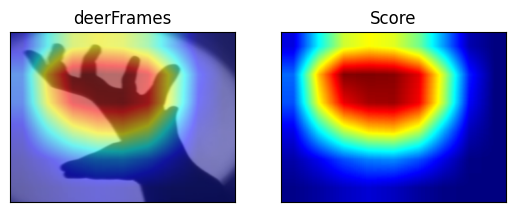

In [124]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/deerFrames/deer_352.PNG').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

[<Figure size 640x480 with 2 Axes>]

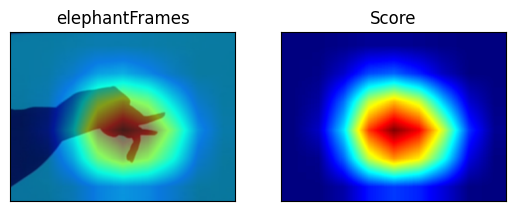

In [131]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image.png').convert('RGB'))
explanations = explainer.explain(img,y=6)
explanations.plot(index=0, class_names=class_names)

/home/cse/.local/lib/python3.10/site-packages/torch/nn/modules/module.py:1344: UserWarning:

Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.



[<Figure size 640x480 with 2 Axes>]

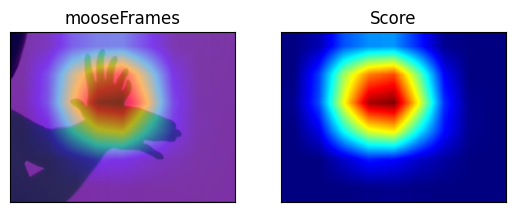

In [127]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image3.png').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

[<Figure size 640x480 with 2 Axes>]

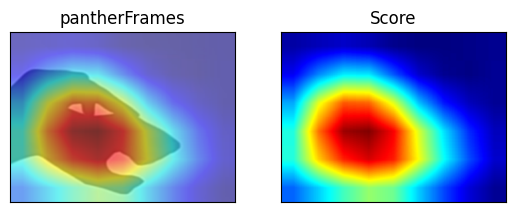

In [128]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/pantherFrames/panther_277.PNG').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

/home/cse/.local/lib/python3.10/site-packages/torch/nn/modules/module.py:1344: UserWarning:

Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.



[<Figure size 640x480 with 2 Axes>]

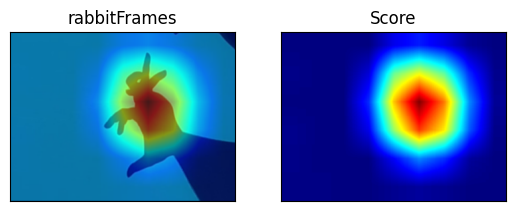

In [129]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image4.png').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

/home/cse/.local/lib/python3.10/site-packages/torch/nn/modules/module.py:1344: UserWarning:

Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.



[<Figure size 640x480 with 2 Axes>]

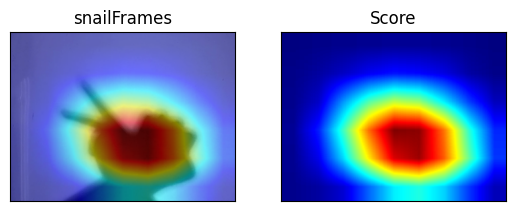

In [132]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image5.png').convert('RGB'))
explanations = explainer.explain(img)
explanations.plot(index=0, class_names=class_names)

In [13]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image5.png').convert('RGB'))

In [14]:
transform = transforms.Compose([
    transforms.Resize(256),
    # transforms.CenterCrop(224),
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
preprocess = lambda ims: torch.stack([transform(im.to_pil()) for im in ims])

  0%|          | 0/1000 [00:00<?, ?it/s]

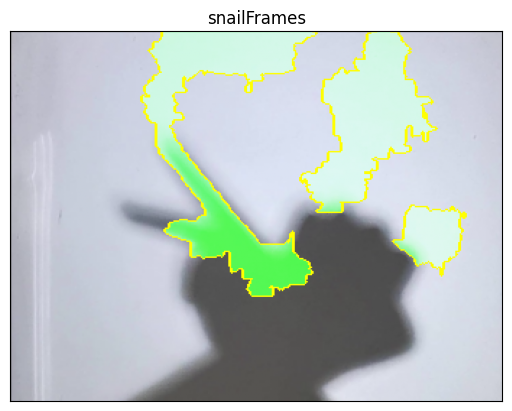

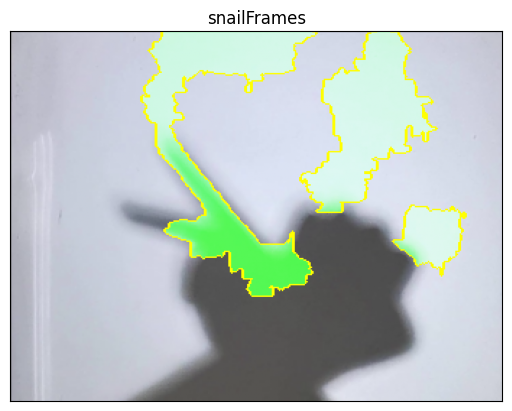

In [15]:
def batch_predict(images):
    # device = "cuda" if torch.cuda.is_available() else "cpu"
    model_best.eval()
    model_best.to(device)
    batch = torch.stack([transform(img.to_pil()) for img in images])
    batch = batch.to(device)
    logits = model_best(batch)
    probs = torch.nn.functional.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

explainer = LimeImage(predict_function=batch_predict)
# Explain the top labels
explanations = explainer.explain(img, hide_color=0, num_samples=1000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

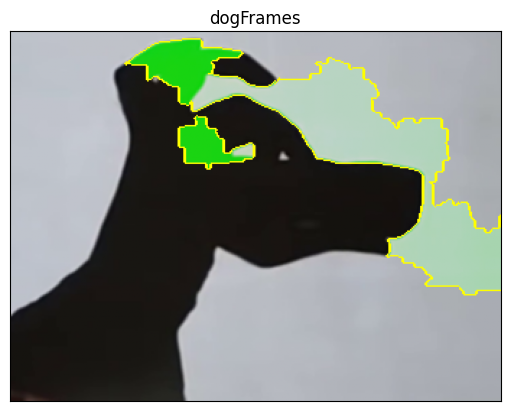

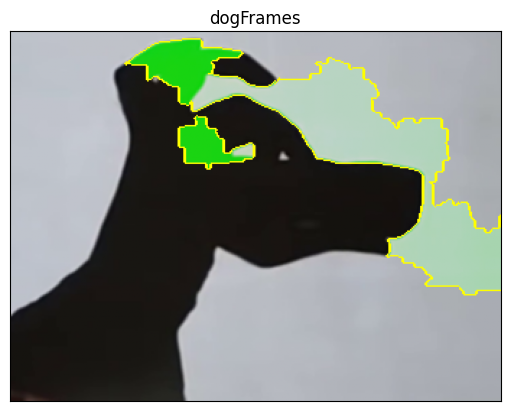

In [17]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/dogFrames/dog_355.PNG').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

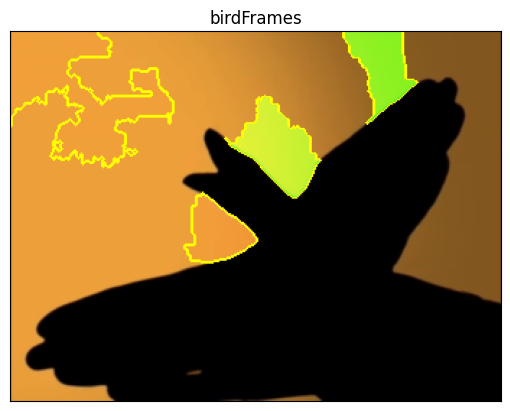

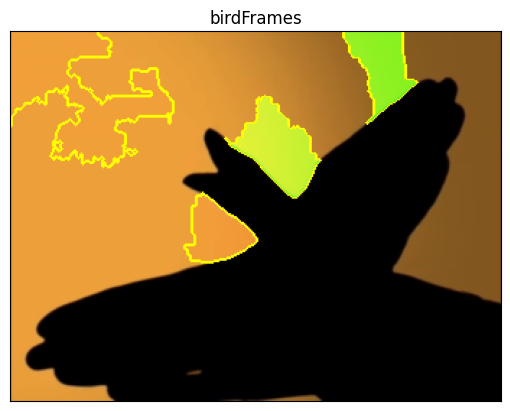

In [18]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/birdFrames/bird_19.PNG').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

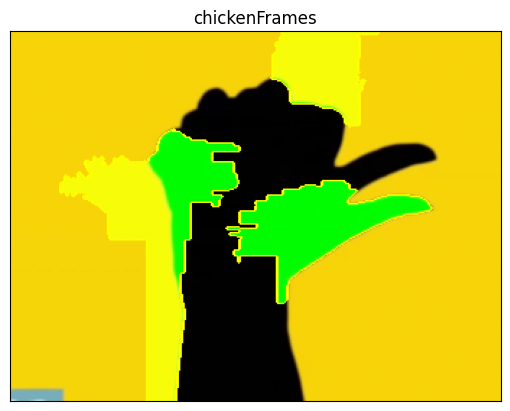

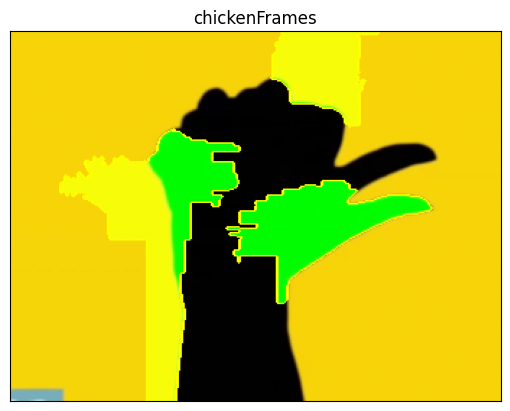

In [19]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/chickenFrames/chicken_471.PNG').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

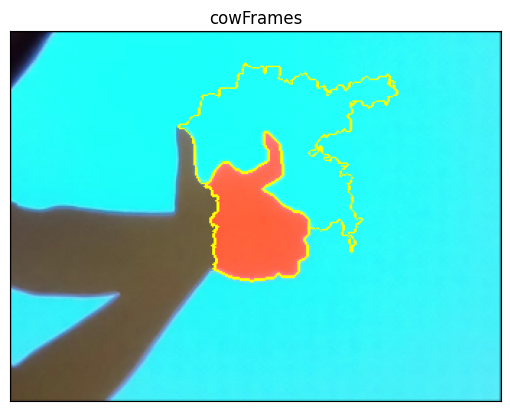

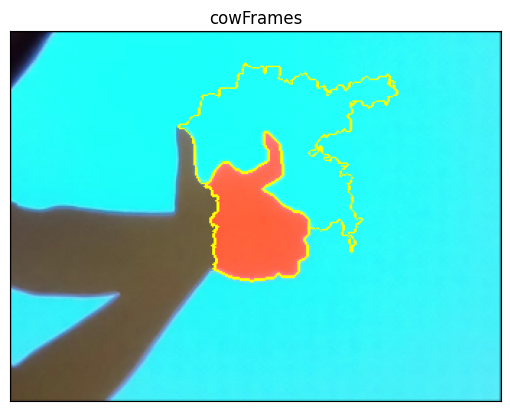

In [20]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image2.png').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

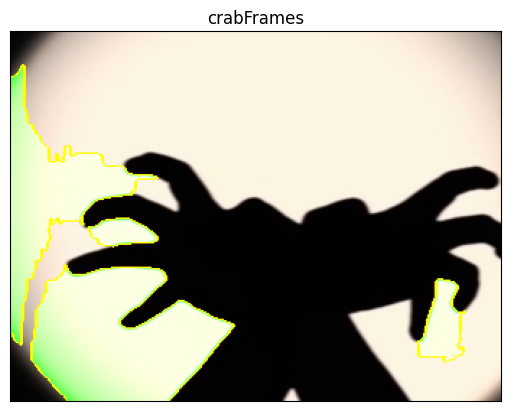

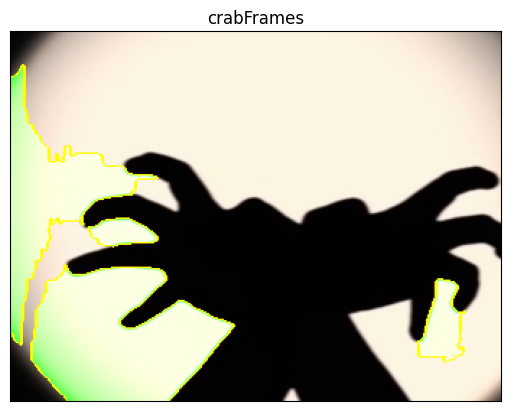

In [21]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/crabFrames/crab_261.PNG').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

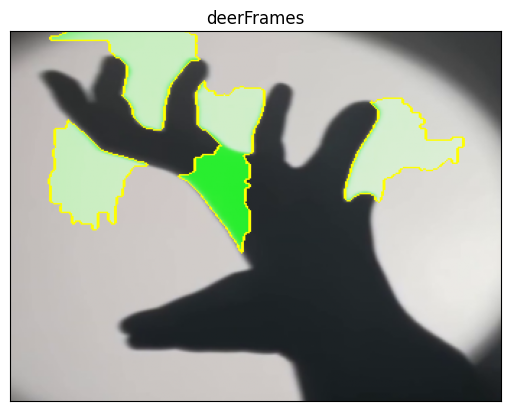

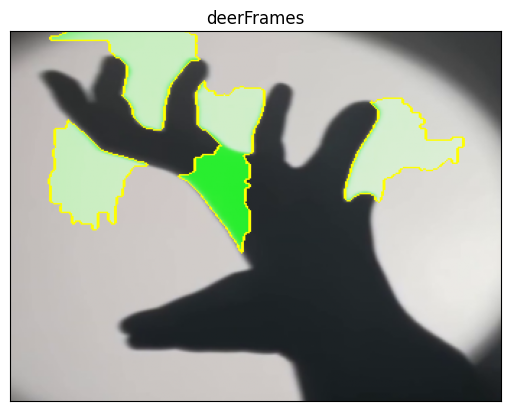

In [22]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/deerFrames/deer_352.PNG').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

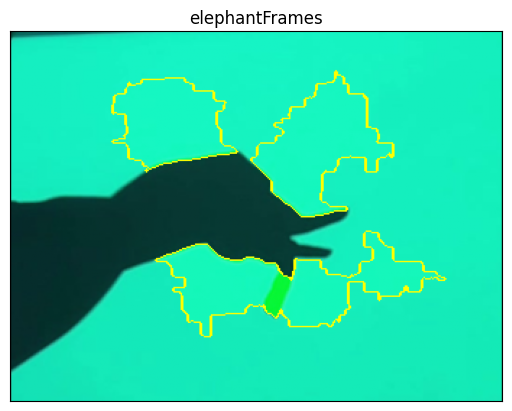

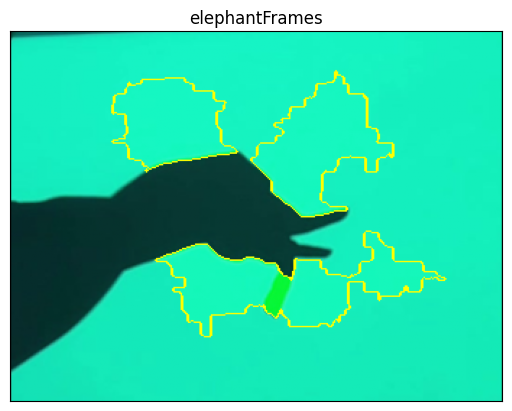

In [23]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image.png').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

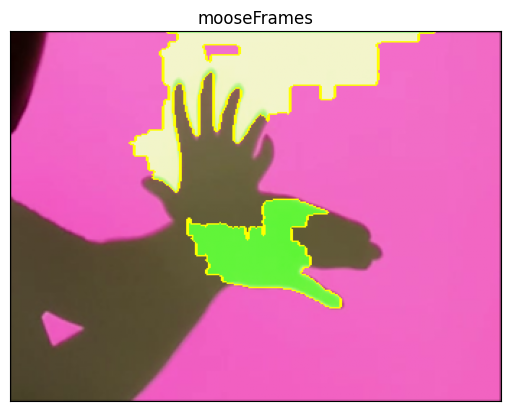

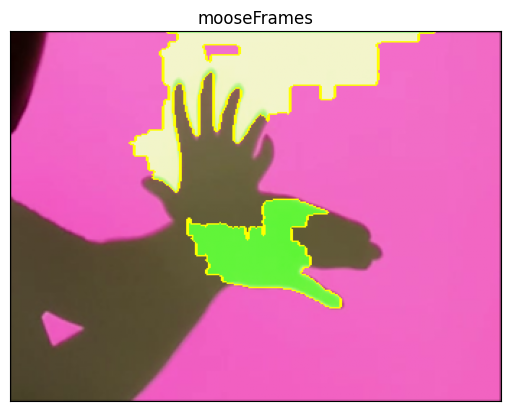

In [24]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image3.png').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

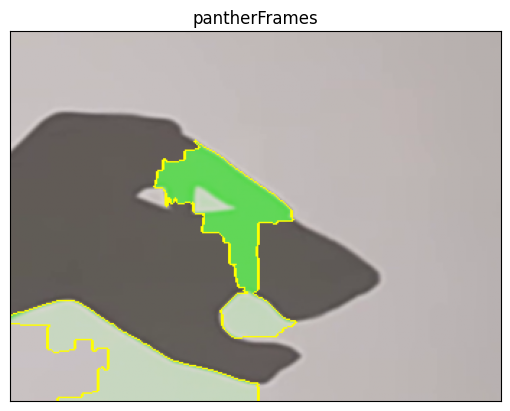

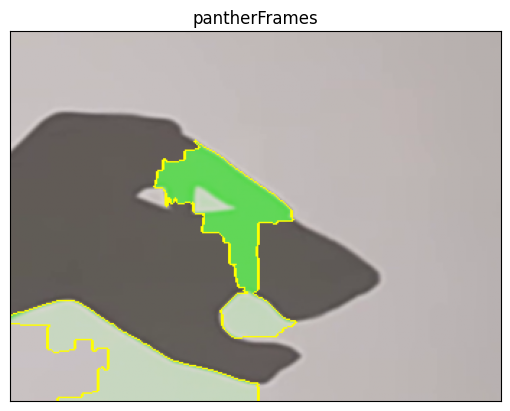

In [25]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/pantherFrames/panther_277.PNG').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

  0%|          | 0/10000 [00:00<?, ?it/s]

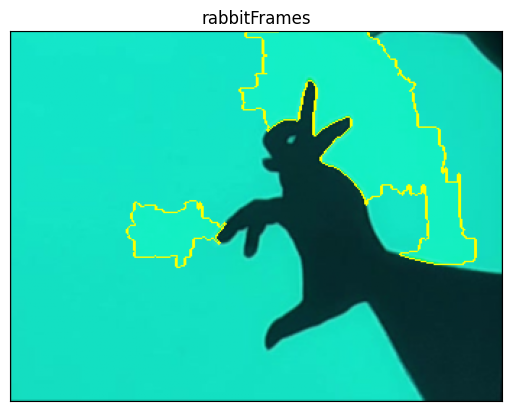

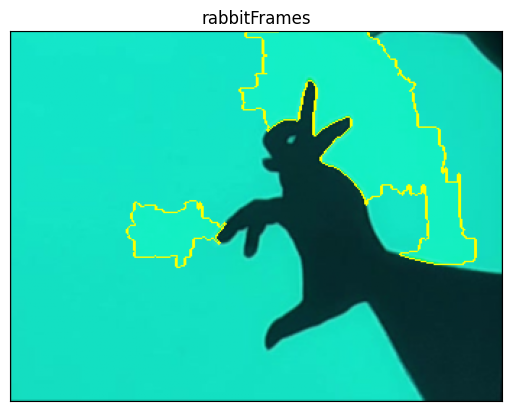

In [26]:
img = Image(PilImage.open('/home/cse/Rifat/HaSPeR/latest/data2/val/image4.png').convert('RGB'))
explanations = explainer.explain(img, hide_color=0, num_samples=10000, top_labels=1)
explanations.plot(index=0, class_names=class_names)

In [47]:
from omnixai.data.image import Image
from omnixai.explainers.vision import ShapImage

In [26]:
print(class_names)

['birdFrames', 'chickenFrames', 'cowFrames', 'crabFrames', 'deerFrames', 'dogFrames', 'elephantFrames', 'mooseFrames', 'pantherFrames', 'rabbitFrames', 'snailFrames']


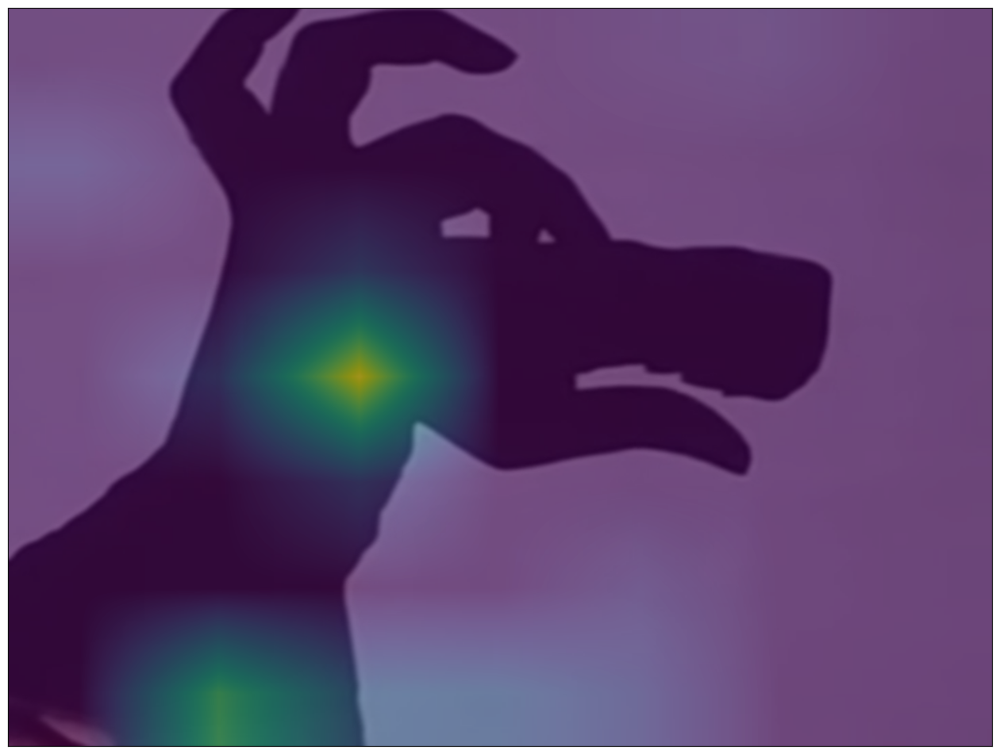

In [141]:
# grad_cam(model, model.classifier[4], '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/dogFrames/dog_369.PNG', 5)
grad_cam(model, model.blocks[3].layers[1].layers.MBconv.layers.conv_c, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/dogFrames/dog_369.PNG', 5)

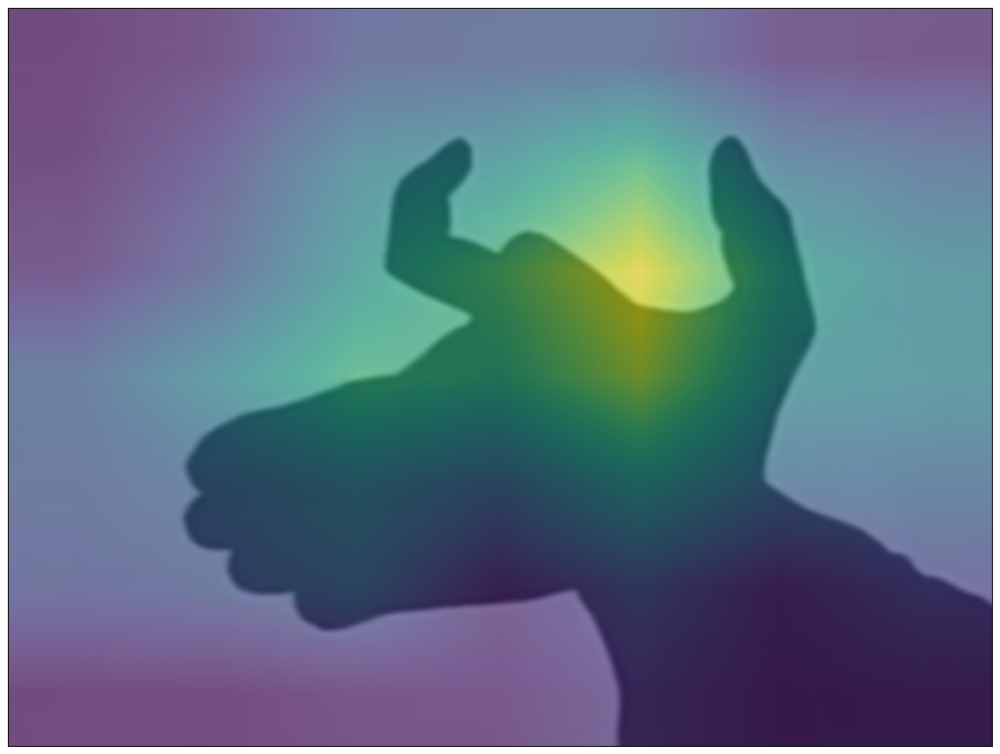

In [142]:
grad_cam(model1, model1.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/cowFrames/cow_269.PNG', 2)

/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torch/nn/modules/module.py:1117: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


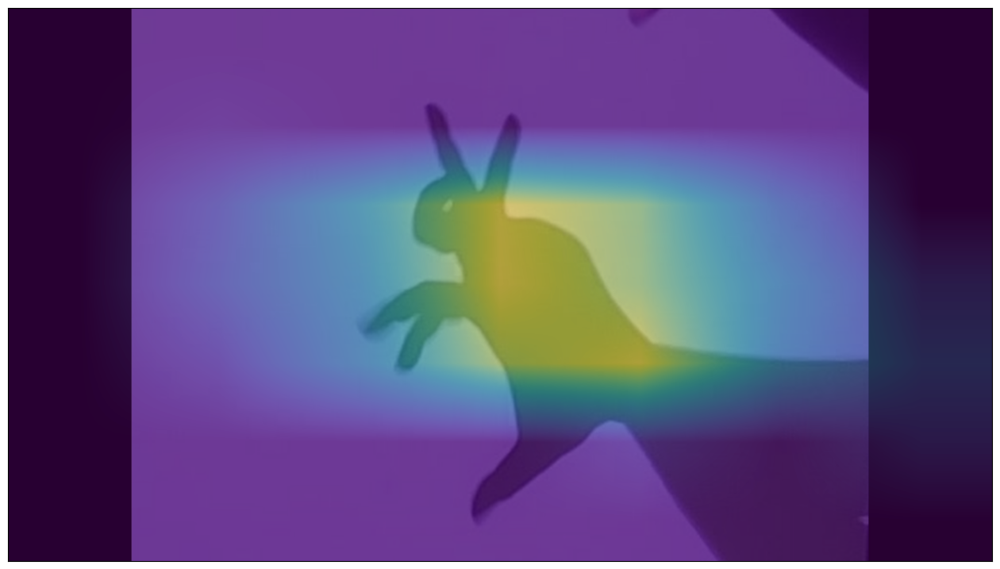

In [10]:
grad_cam(model1, model1.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/rabbitFrames/rabbit_514.PNG', 9)

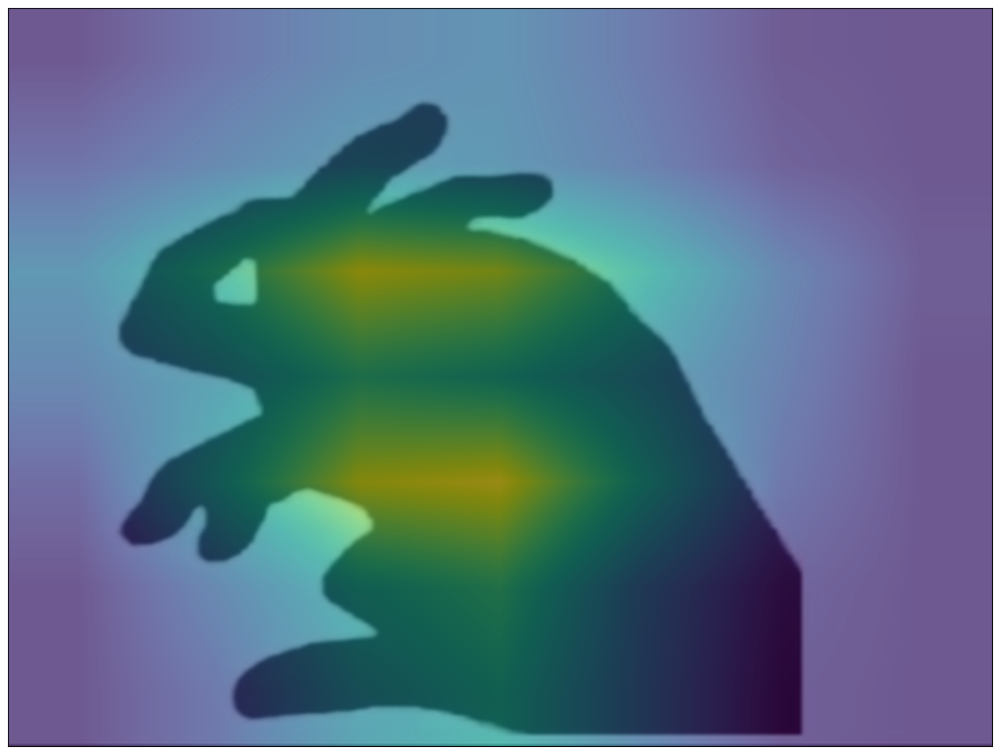

In [11]:
grad_cam(model1, model1.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/rabbitFrames/rabbit_454.PNG', 9)

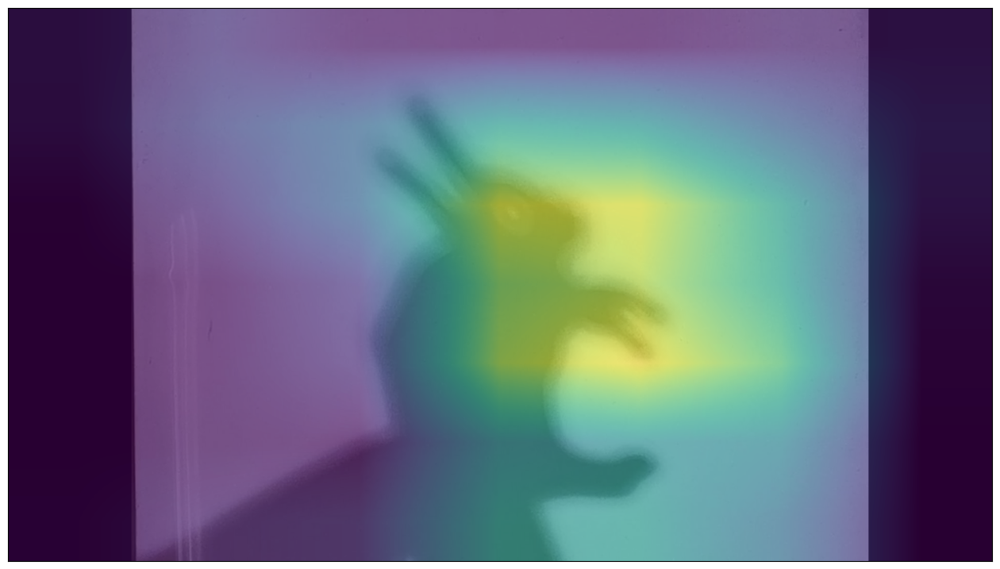

: 

In [12]:
grad_cam(model1, model1.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/rabbitFrames/rabbit_619.PNG', 9)

In [11]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(1))
print(torch.cuda.current_device())

True
NVIDIA GeForce RTX 3090
0


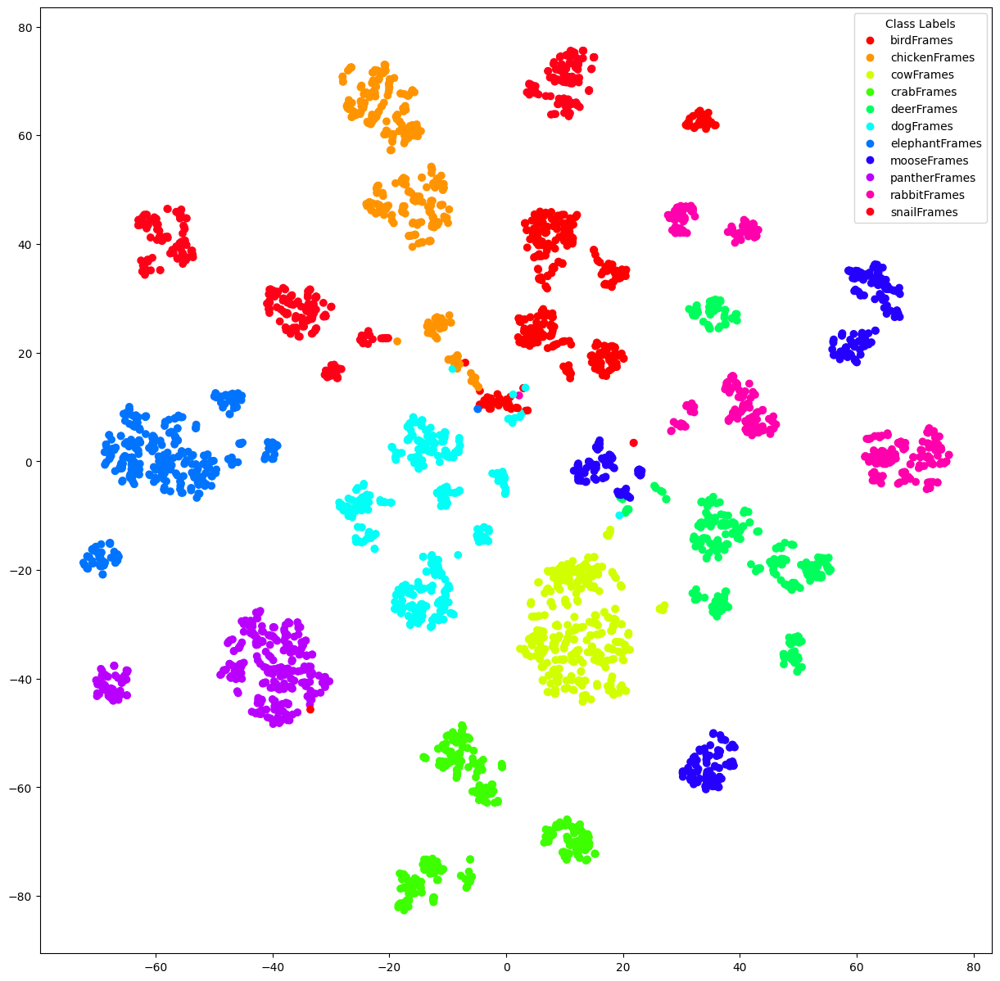

In [15]:
output_tsne_data = get_tsne(outputsList)
plot_representations(output_tsne_data, labelsList, class_names)

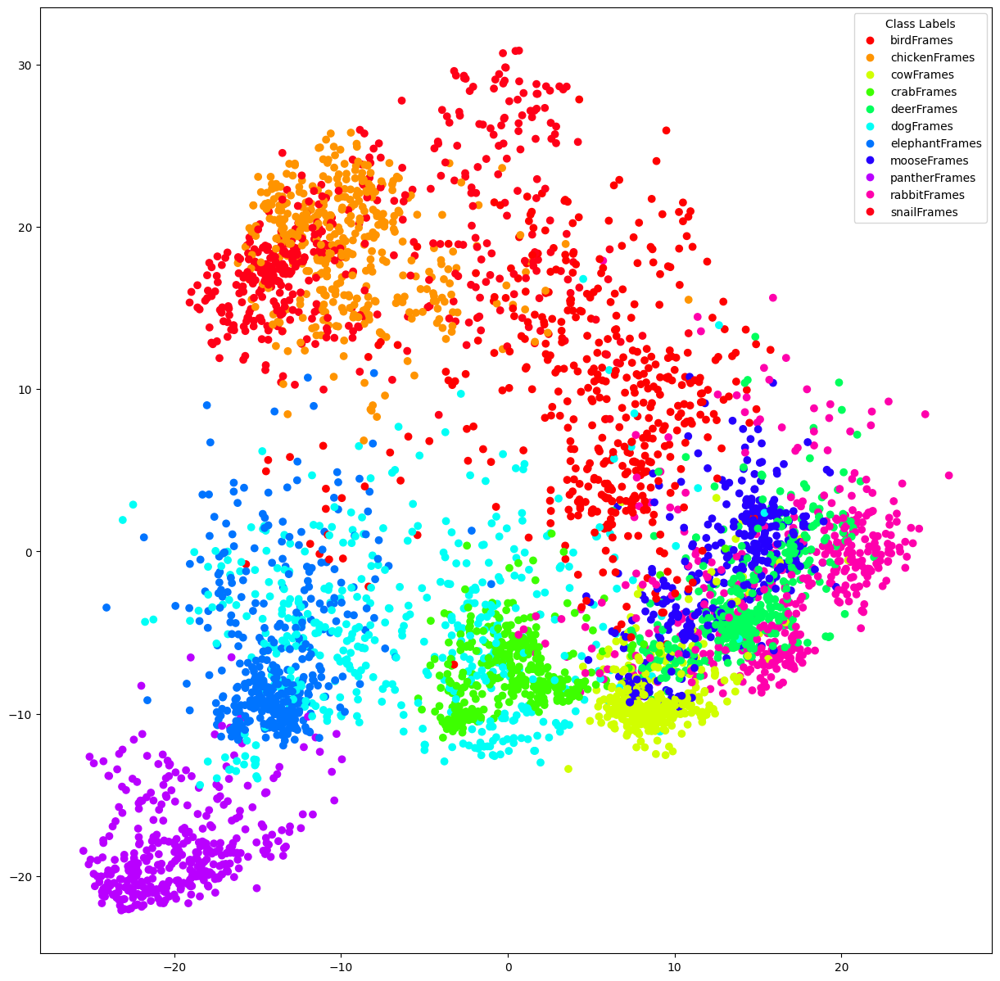

In [56]:
output_pca_data = get_pca(outputsList)
plot_representations(output_pca_data, labelsList, class_names)

/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


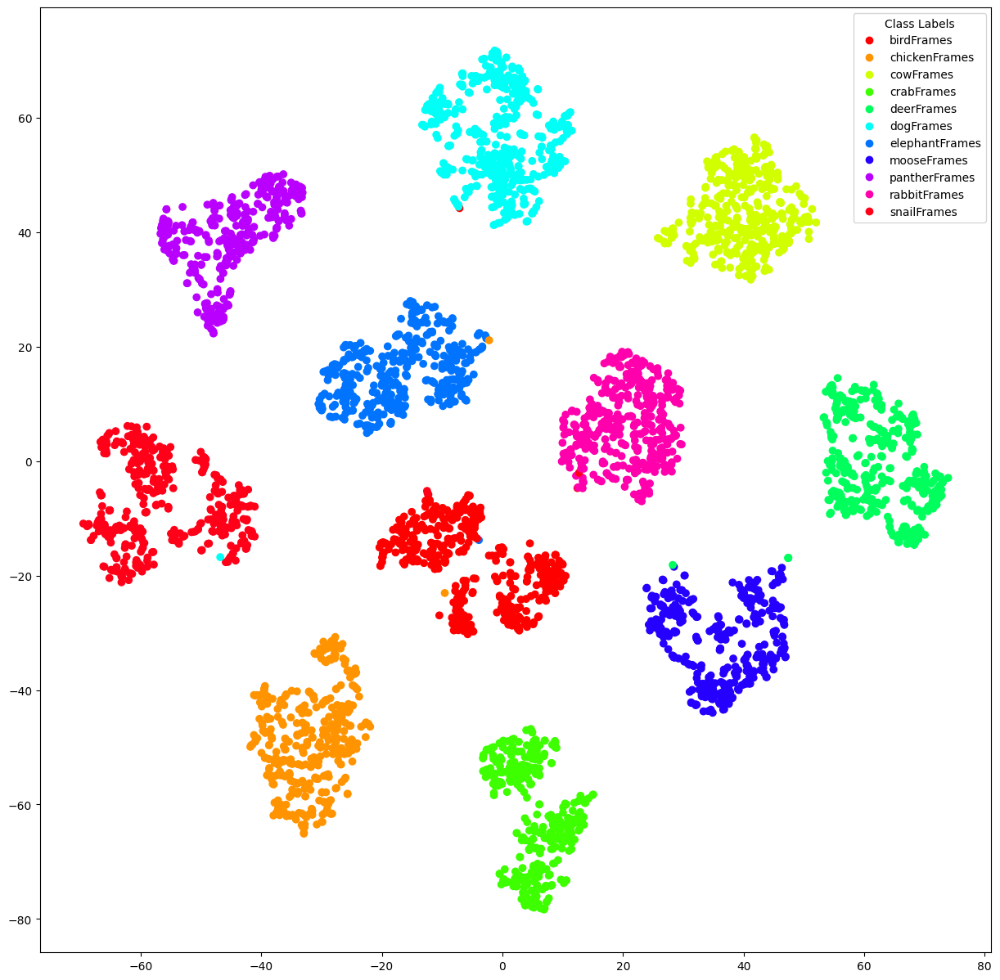

In [54]:
model2 = models.googlenet(pretrained=True)
num_ftrs2 = model2.fc.in_features
model2.fc = nn.Linear(num_ftrs2, 11)
loaded_model2 = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_GoogLeNet.pt')
# print(loaded_model.keys())
model2.load_state_dict(loaded_model2, strict=False)
model2.eval().to(device)

outputsList2, labelsList2 = get_representations(model2, dataloaders['train'])

output_tsne_data2 = get_tsne(outputsList2)
plot_representations(output_tsne_data2, labelsList2, class_names)

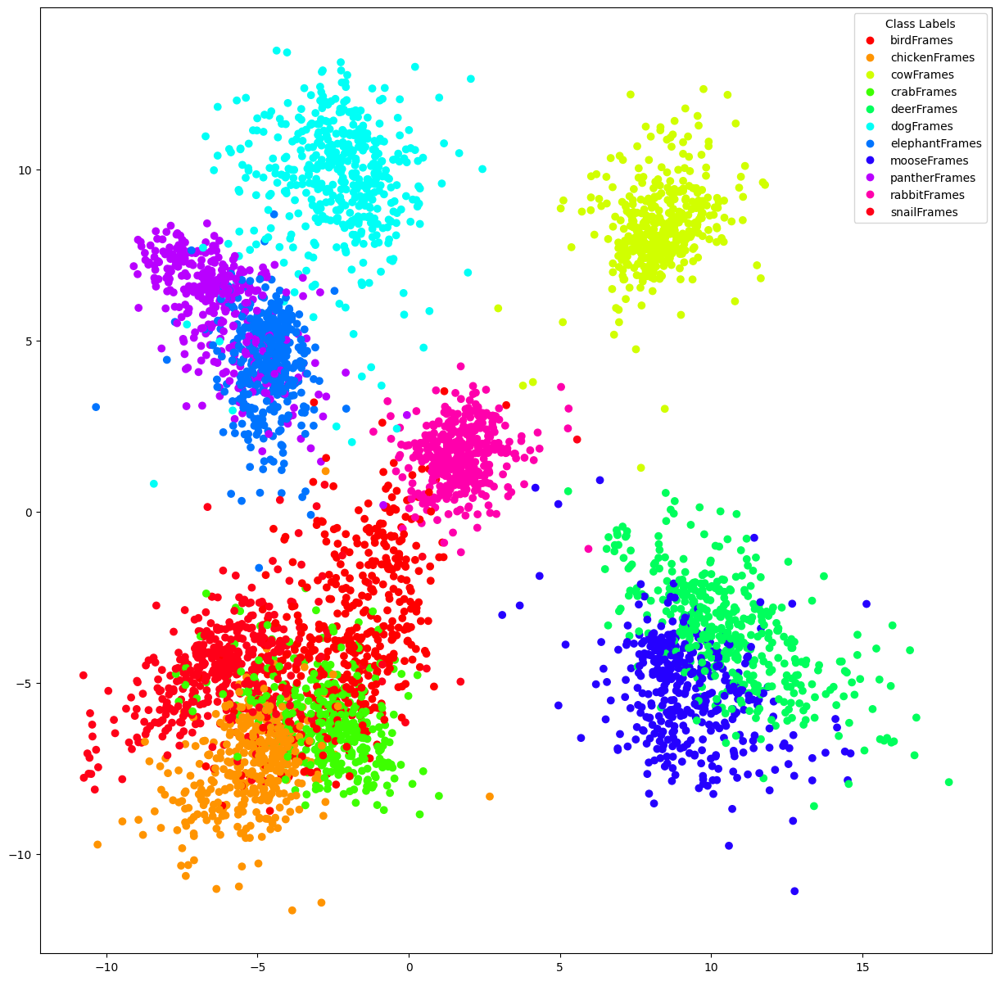

In [57]:
output_pca_data2 = get_pca(outputsList2)
plot_representations(output_pca_data2, labelsList2, class_names)

In [32]:
def visualize_modelGoogLeNet(model, num_images=6):
    was_training = model.training
    model.eval().to(device)
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
#             inputs = F.interpolate(inputs, size=(224,224), antialias=True, mode='bilinear')
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

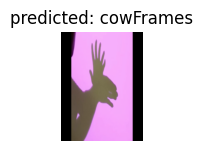

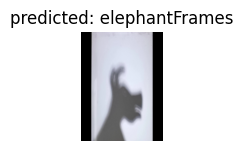

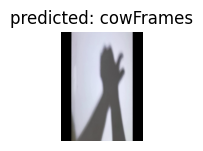

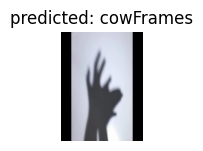

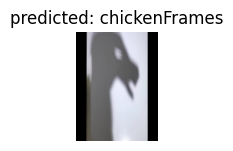

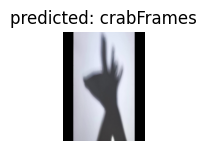

In [33]:
visualize_modelGoogLeNet(model2)

/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


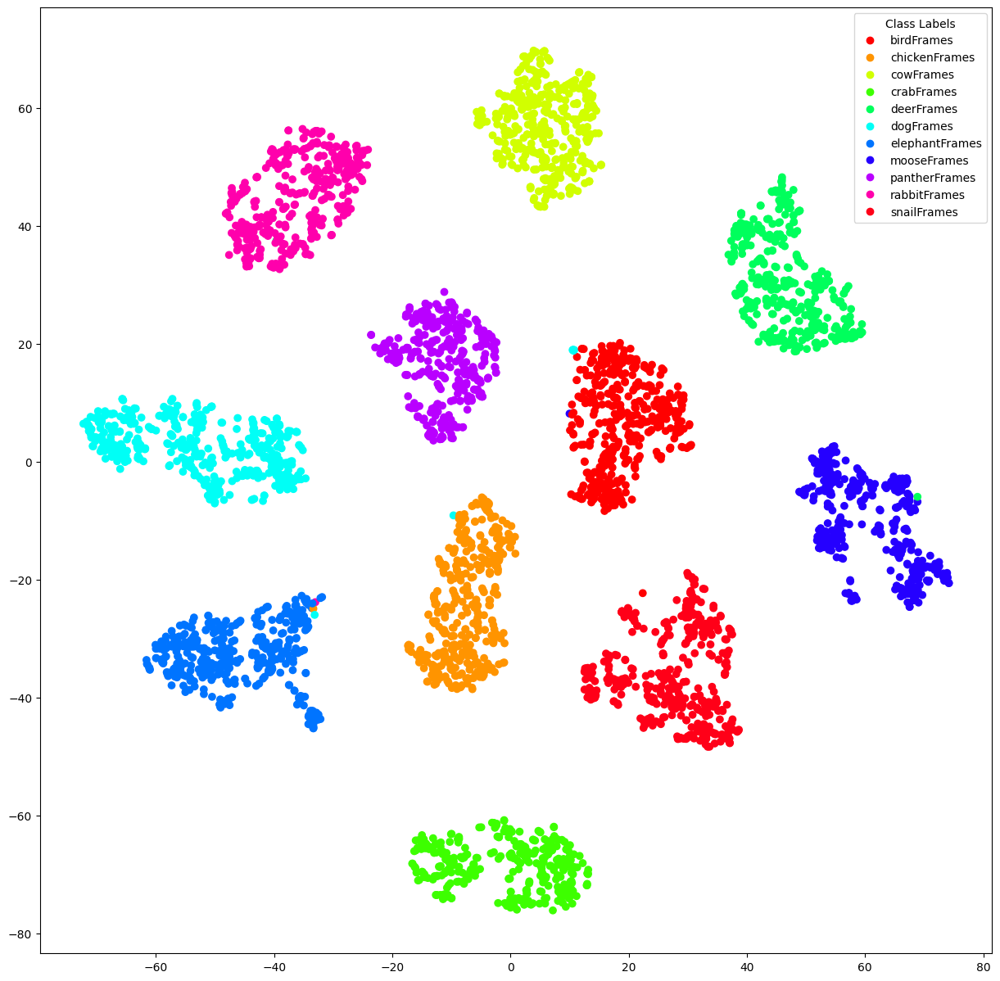

In [53]:
model3 = models.inception_v3(pretrained=True)
num_ftrs3 = model3.fc.in_features
model3.fc = nn.Linear(num_ftrs3, 11)
loaded_model3 = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_InceptionV3.pt')
# print(loaded_model.keys())
model3.load_state_dict(loaded_model3, strict=False)
model3.eval().to(device)

outputsList3, labelsList3 = get_representations(model3, dataloaders['train'])

output_tsne_data3 = get_tsne(outputsList3)
plot_representations(output_tsne_data3, labelsList3, class_names)

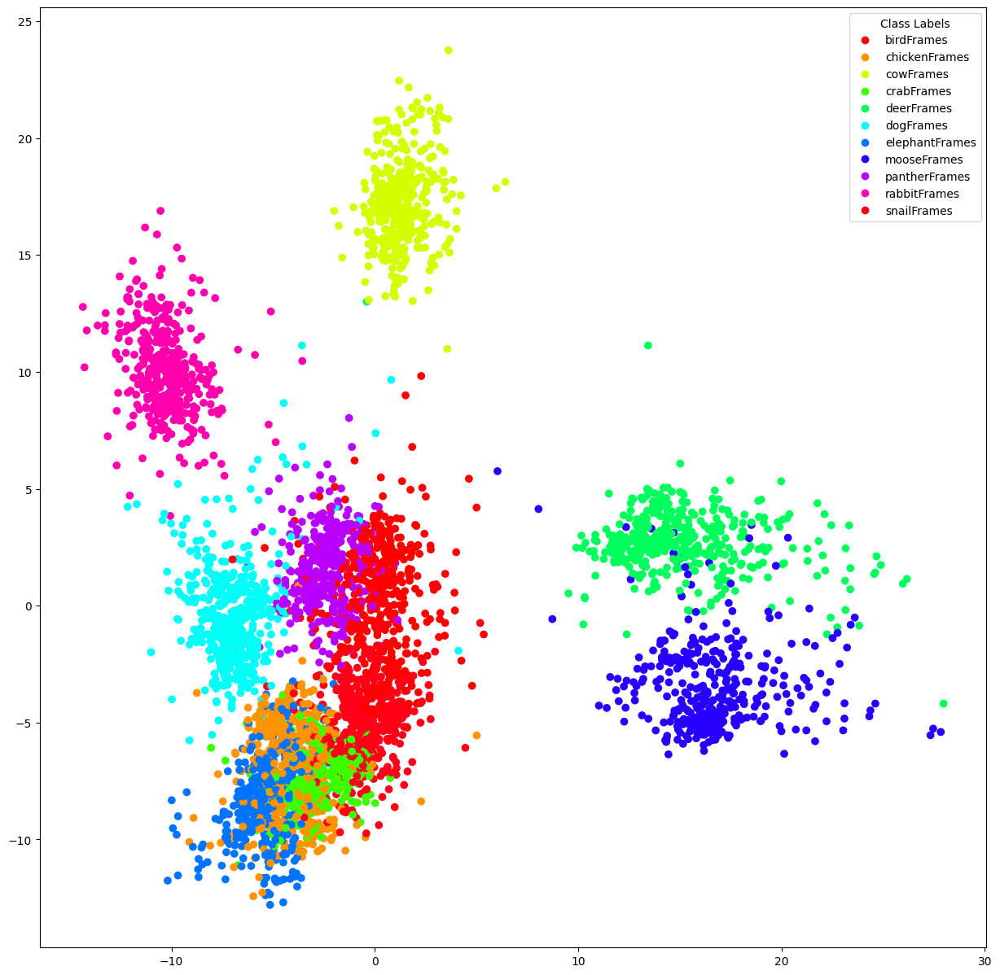

In [58]:
output_pca_data3 = get_pca(outputsList3)
plot_representations(output_pca_data3, labelsList3, class_names)

In [64]:
print(model3)

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

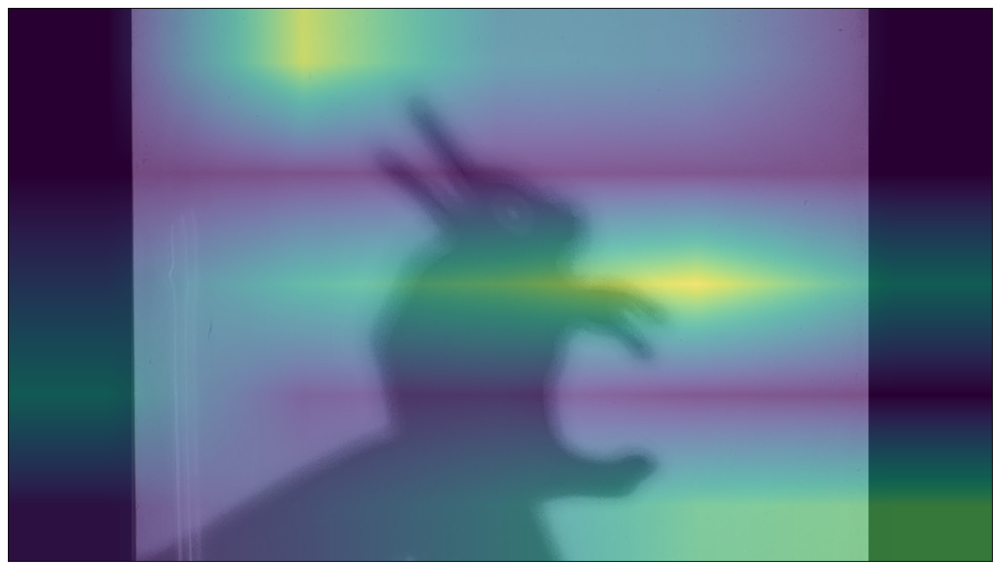

In [79]:
grad_cam(model3, model3.Mixed_7b.branch3x3dbl_3b.conv, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/rabbitFrames/rabbit_619.PNG', 9)

/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V3_Large_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V3_Large_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


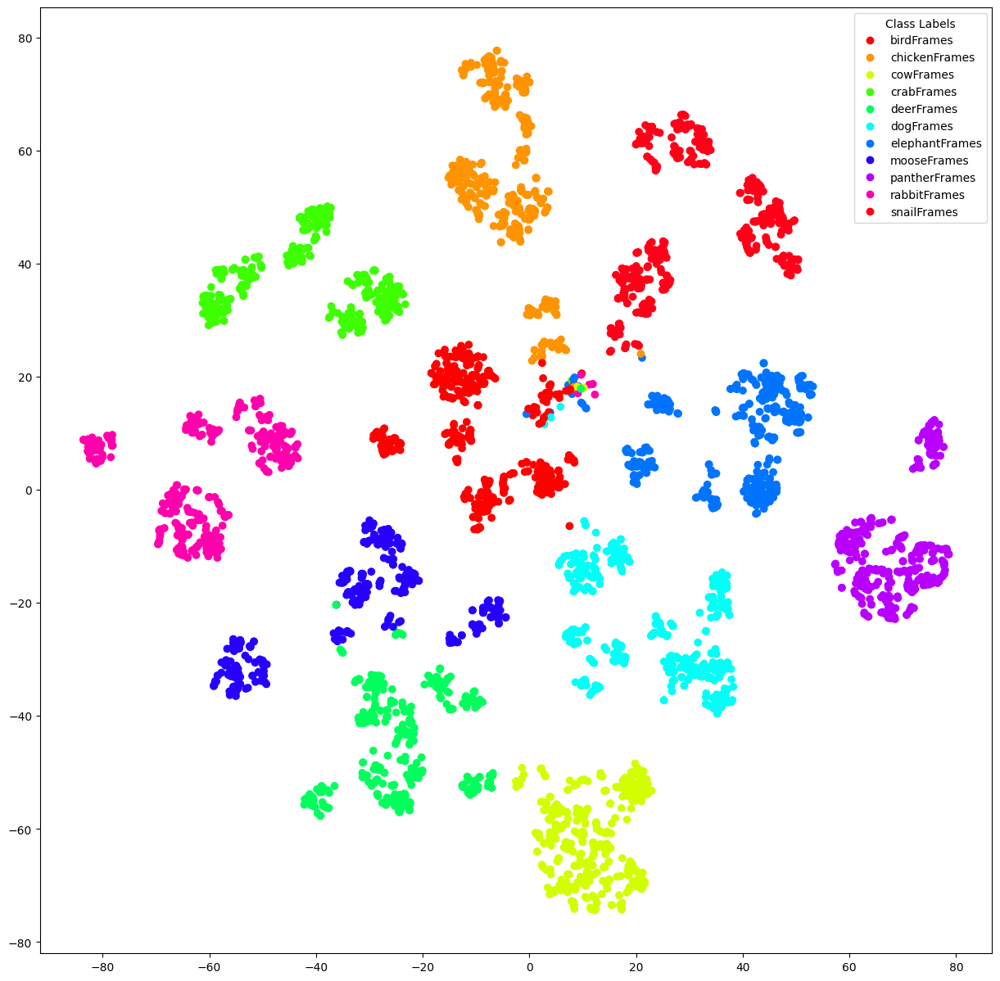

In [51]:
model4 = models.mobilenet_v3_large(pretrained=True)
num_ftrs4 = model4.classifier[3].in_features
model4.fc = nn.Linear(num_ftrs4, 11)
loaded_model4 = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_MobileNetV3Large.pt')
# print(loaded_model.keys())
model4.load_state_dict(loaded_model4, strict=False)
model4.eval().to(device)

outputsList4, labelsList4 = get_representations(model4, dataloaders['train'])

output_tsne_data4 = get_tsne(outputsList4)
plot_representations(output_tsne_data4, labelsList4, class_names)

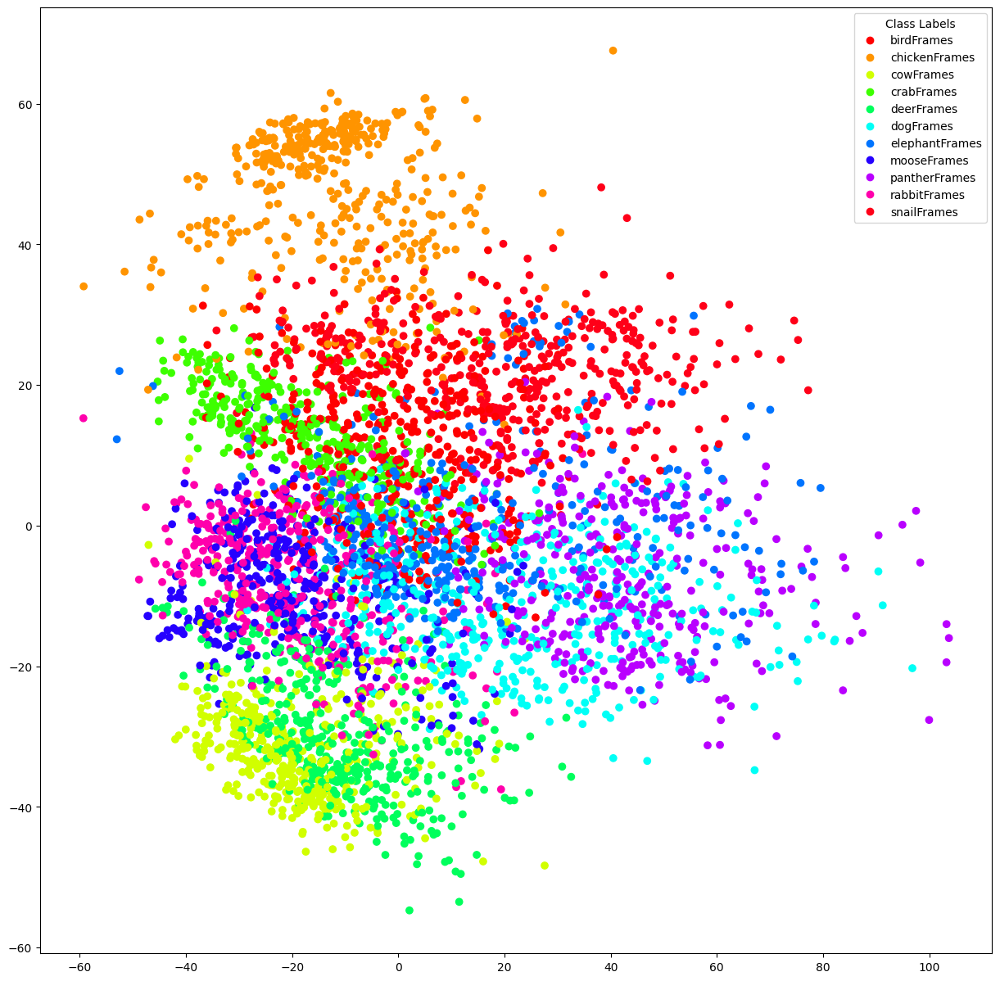

In [59]:
output_pca_data4 = get_pca(outputsList4)
plot_representations(output_pca_data4, labelsList4, class_names)

/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


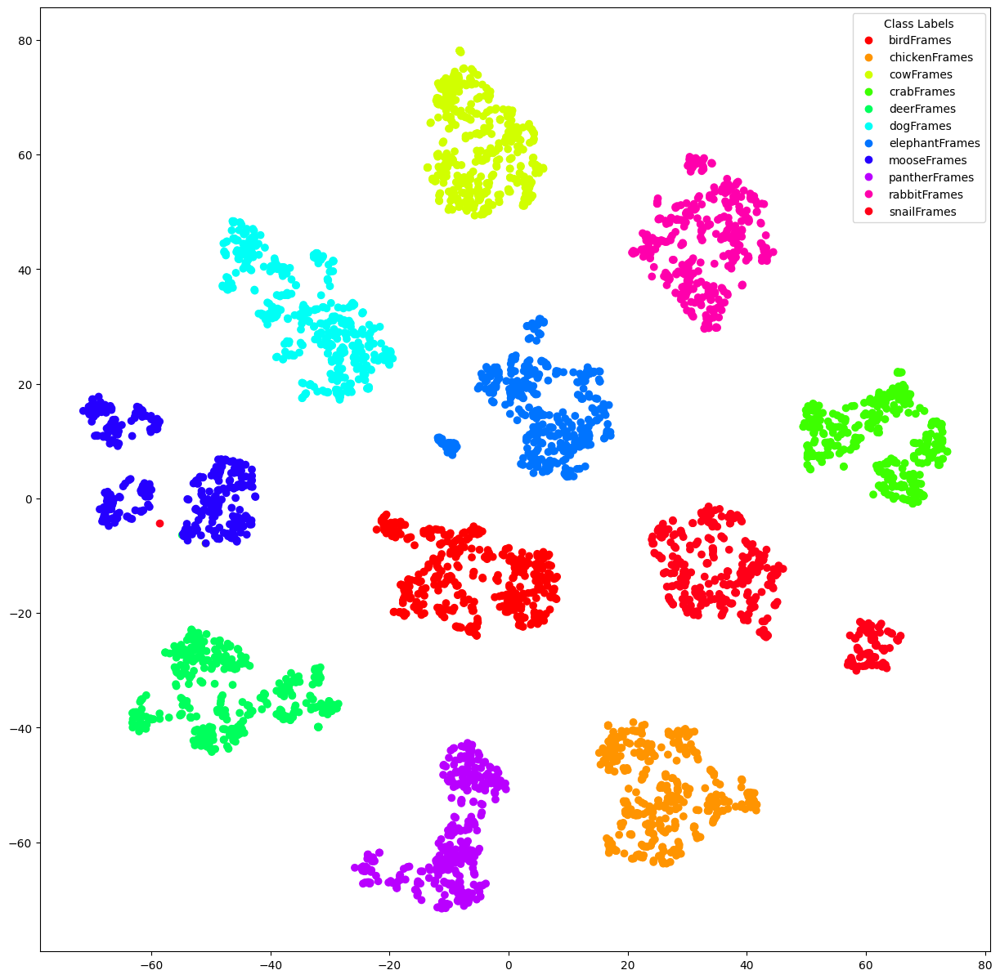

In [52]:
model5 = models.resnet152(pretrained=True)
num_ftrs5 = model5.fc.in_features
model5.fc = nn.Linear(num_ftrs5, 11)
loaded_model5 = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_ResNet152_1.pt')
# print(loaded_model.keys())
model5.load_state_dict(loaded_model5, strict=False)
model5.eval().to(device)

outputsList5, labelsList5 = get_representations(model5, dataloaders['train'])

output_tsne_data5 = get_tsne(outputsList5)
plot_representations(output_tsne_data5, labelsList5, class_names)

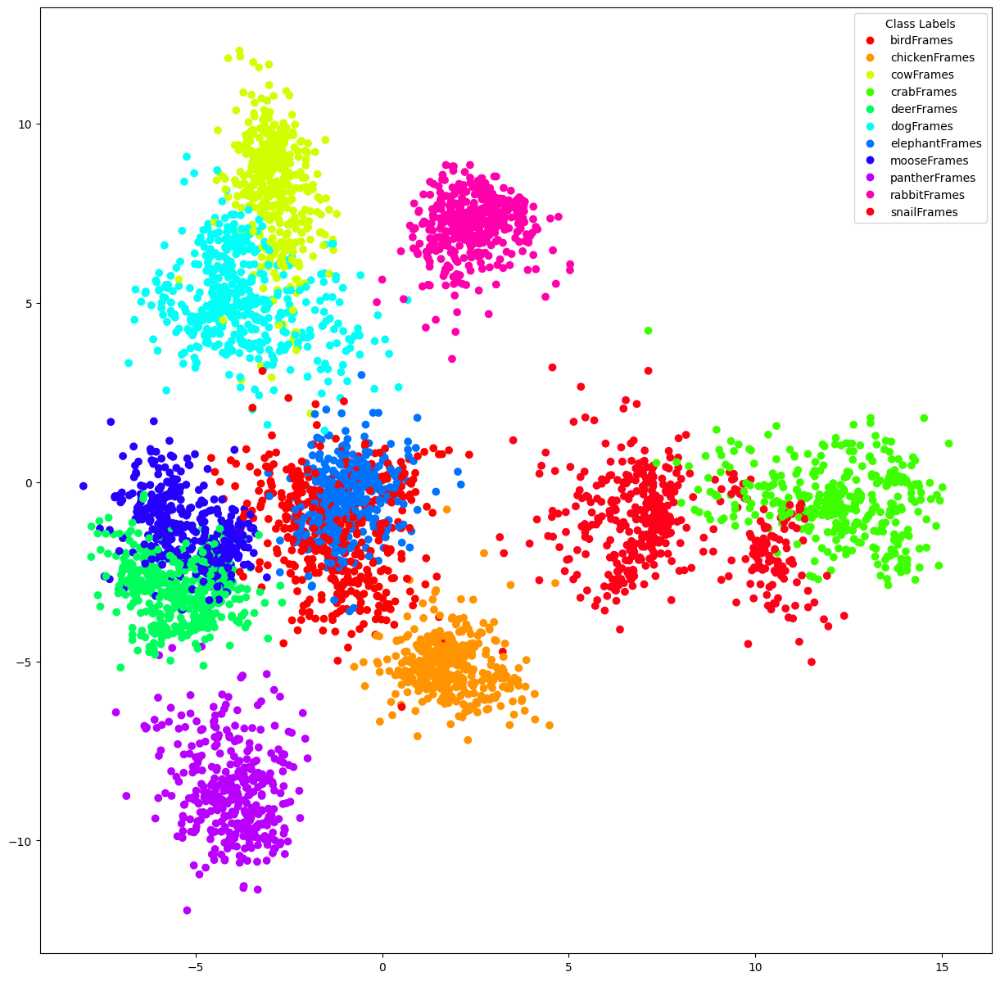

In [60]:
output_pca_data5 = get_pca(outputsList5)
plot_representations(output_pca_data5, labelsList5, class_names)

In [80]:
print(model5)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

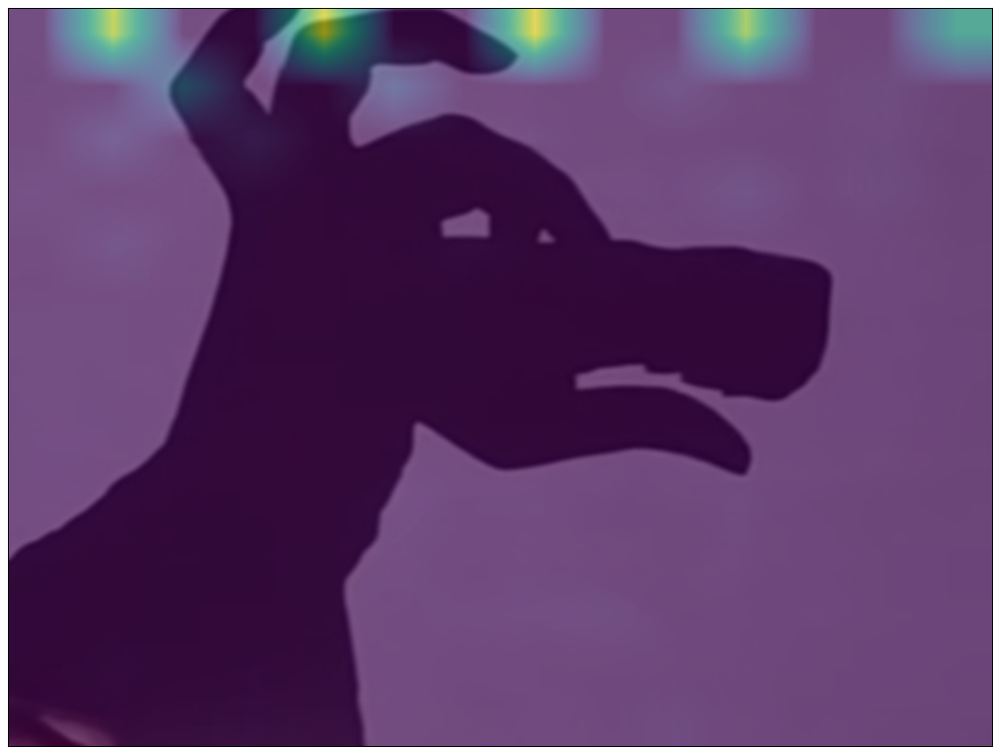

In [88]:
grad_cam(model5, model5.layer3[35].bn1, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/dogFrames/dog_369.PNG', 5)

/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/dlpc01/anaconda3/envs/rifat/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=RegNet_X_32GF_Weights.IMAGENET1K_V1`. You can also use `weights=RegNet_X_32GF_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


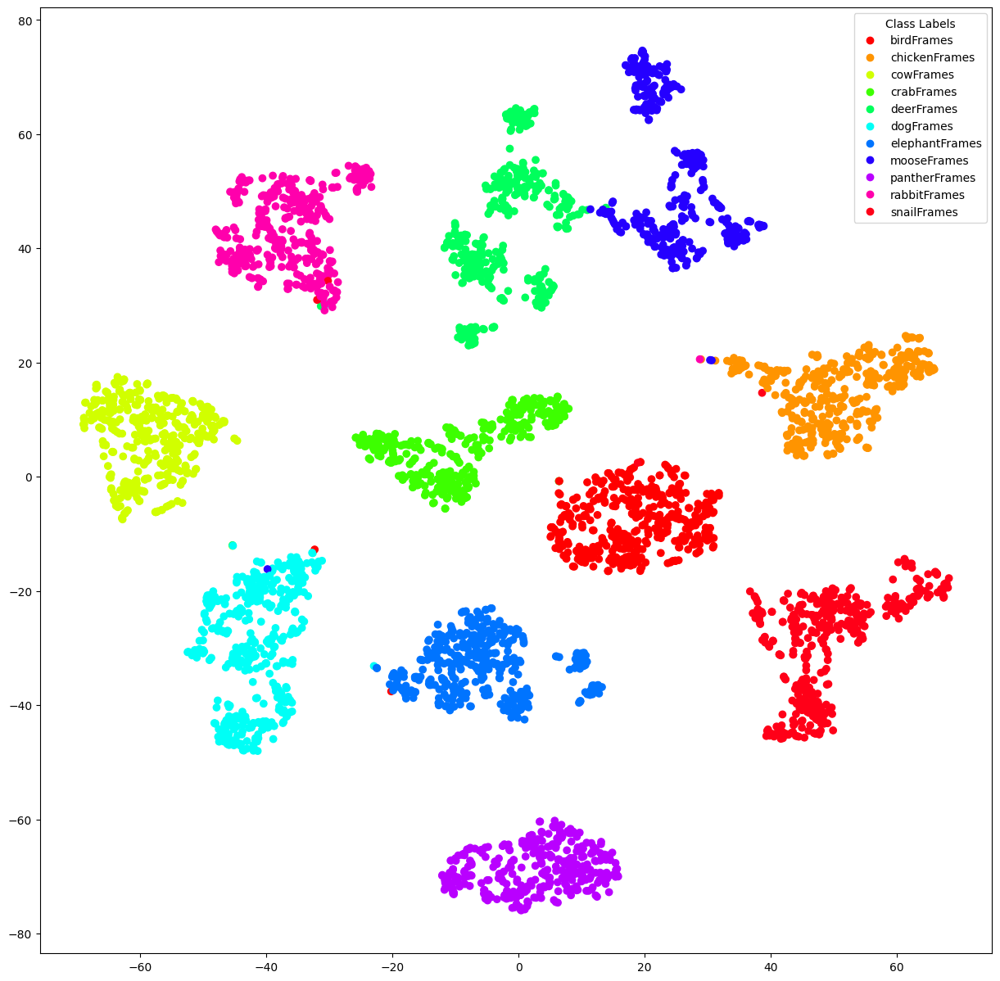

In [61]:
model6 = models.regnet_x_32gf(pretrained=True)
num_ftrs6 = model6.fc.in_features
model6.fc = nn.Linear(num_ftrs6, 11)
loaded_model6 = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_RegNetX32GF.pt')
# print(loaded_model.keys())
model6.load_state_dict(loaded_model6, strict=False)
model6.eval().to(device)

outputsList6, labelsList6 = get_representations(model6, dataloaders['train'])

output_tsne_data6 = get_tsne(outputsList6)
plot_representations(output_tsne_data6, labelsList6, class_names)

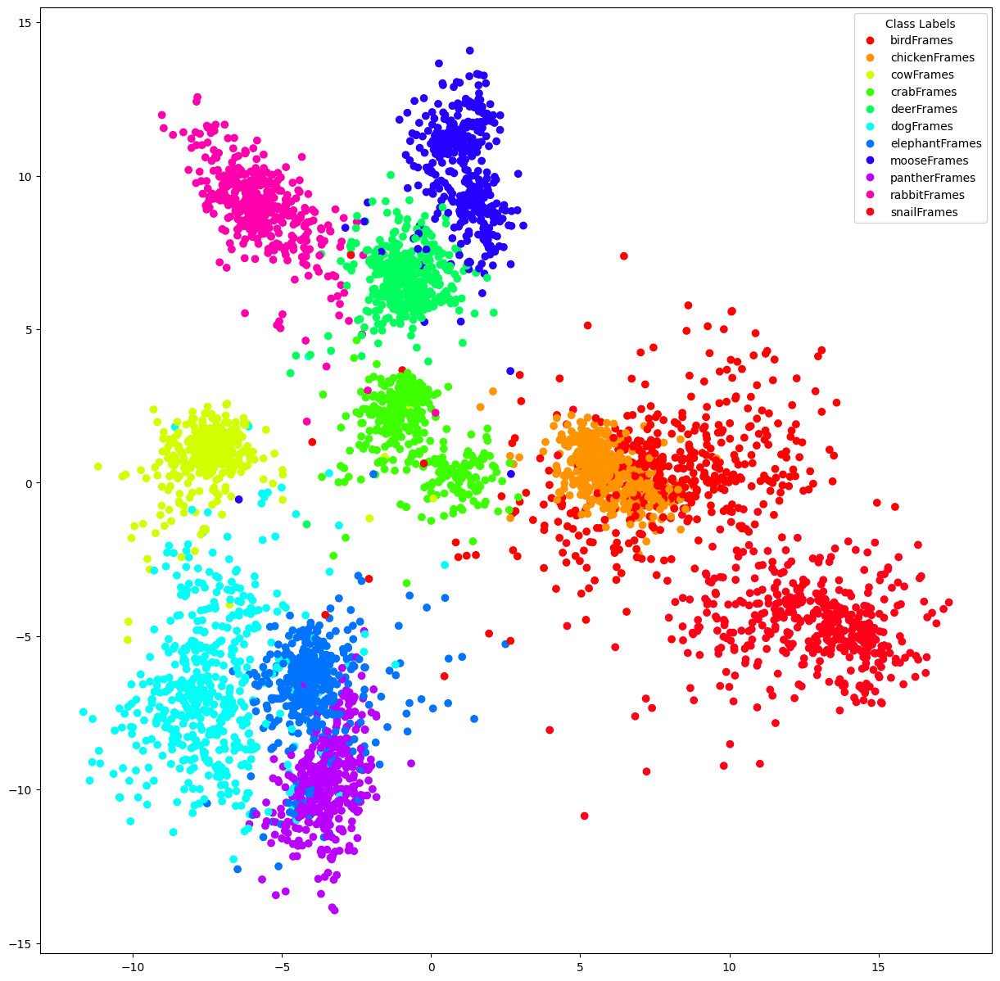

In [62]:
output_pca_data6 = get_pca(outputsList6)
plot_representations(output_pca_data6, labelsList6, class_names)

In [90]:
model7 = models.densenet201(pretrained=True)
num_ftrs7 = model7.classifier.in_features
model7.fc = nn.Linear(num_ftrs7, 11)
loaded_model7 = torch.load('/home/dlpc01/Rifat/saved_models/HSPR_DenseNet201_1.pt')
# print(loaded_model.keys())
model7.load_state_dict(loaded_model7, strict=False)
model7.eval().to(device)

# outputsList6, labelsList6 = get_representations(model6, dataloaders['train'])

# output_tsne_data6 = get_tsne(outputsList6)
# plot_representations(output_tsne_data6, labelsList6, class_names)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

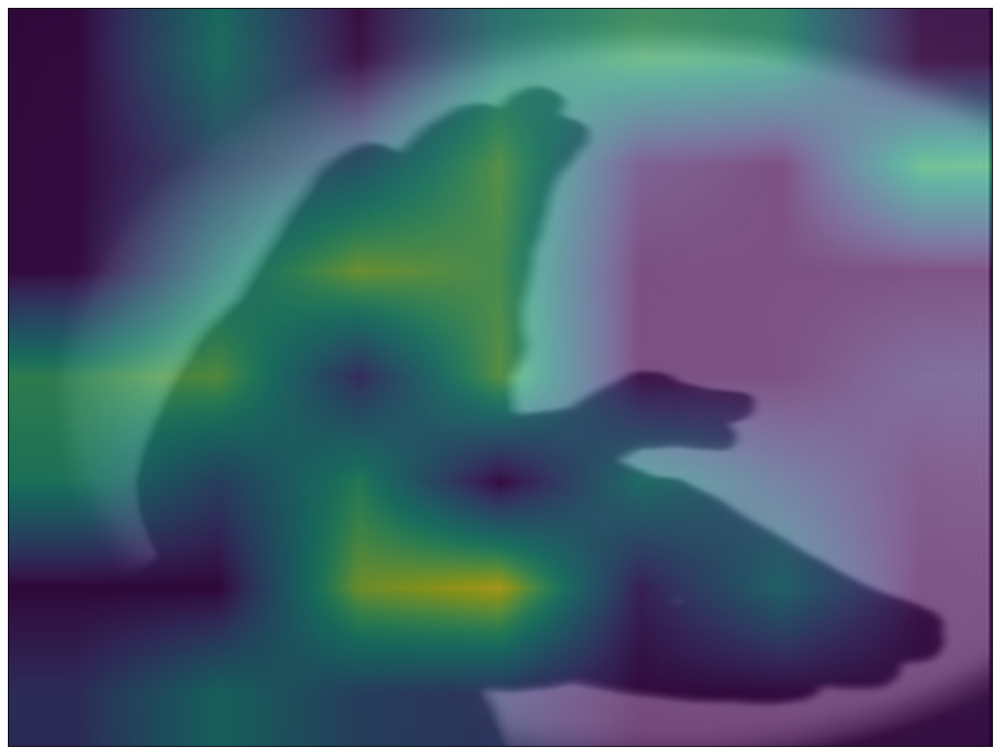

In [115]:
grad_cam(model7, model7.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/birdFrames/bird_224.PNG', 0)

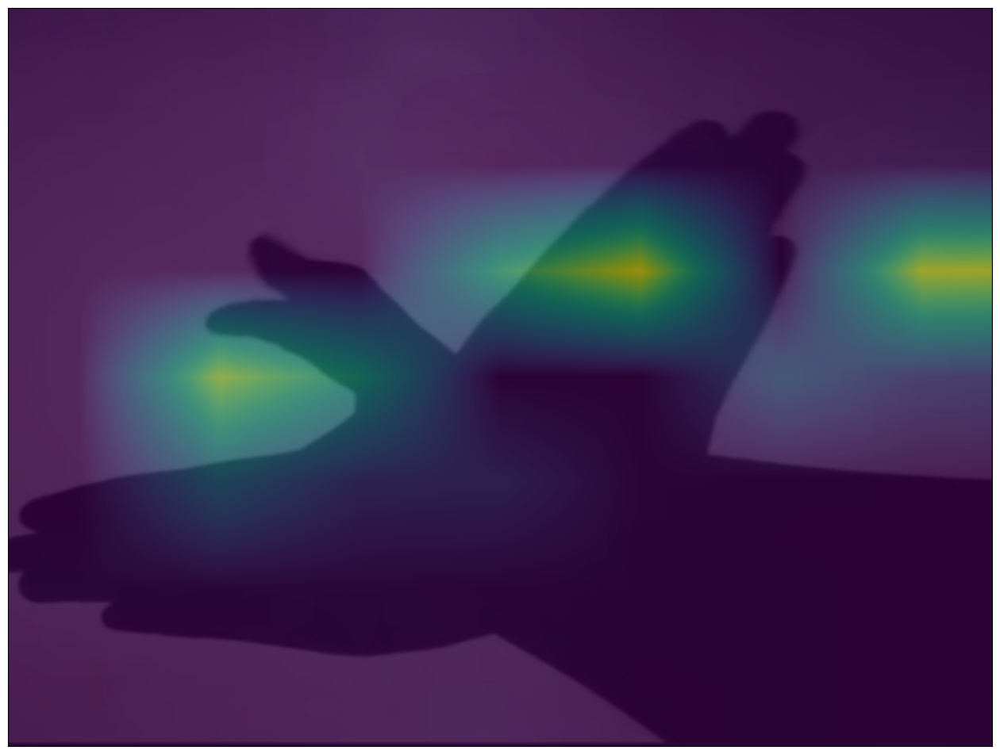

In [152]:
grad_cam(model7, model7.features.denseblock4.denselayer3.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/birdFrames/bird_489.PNG', 0)

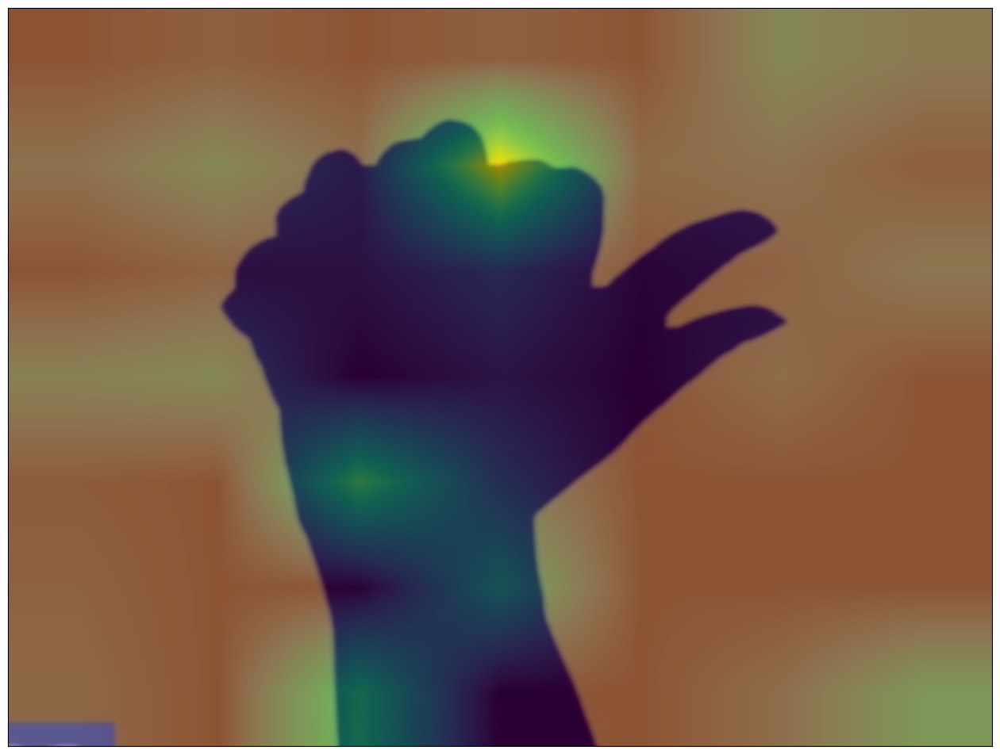

In [128]:
grad_cam(model7, model7.features.denseblock4.denselayer20.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/chickenFrames/chicken_498.PNG', 1)

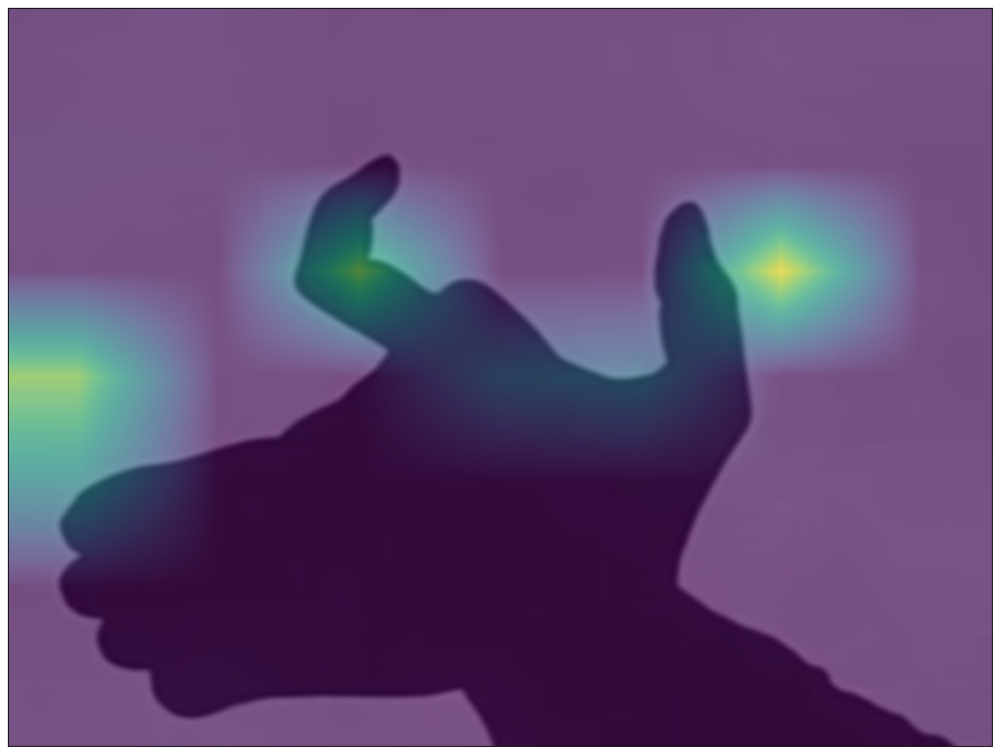

In [157]:
grad_cam(model7, model7.features.denseblock4.denselayer20.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/cowFrames/cow_35.PNG', 2)

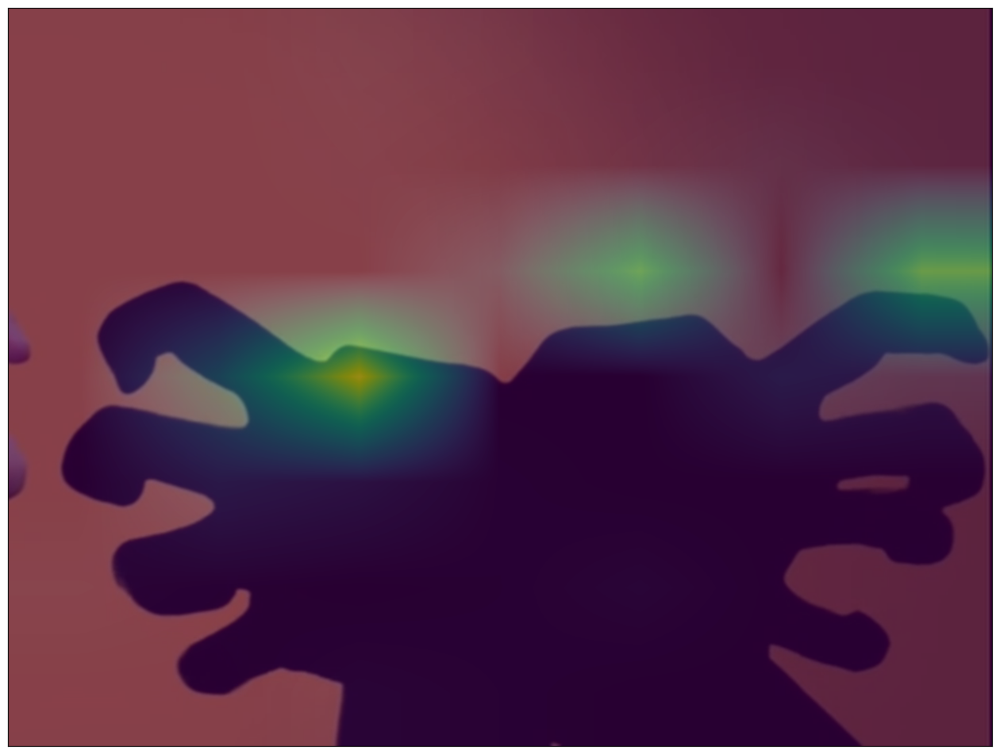

In [170]:
grad_cam(model7, model7.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/crabFrames/crab_93.PNG', 3)

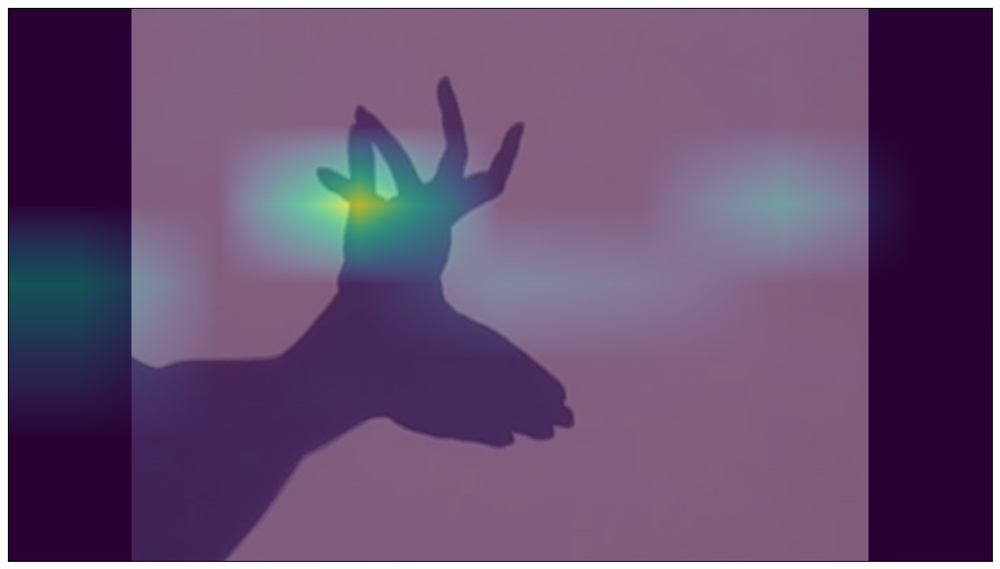

In [174]:
grad_cam(model7, model7.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/deerFrames/deer_609.PNG', 4)

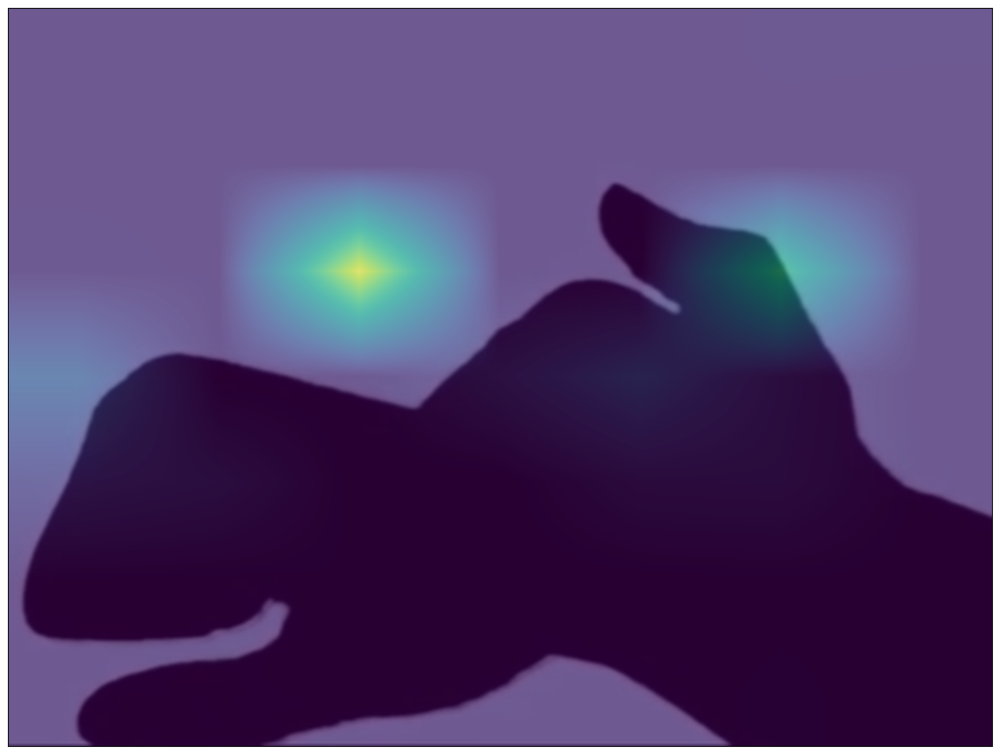

In [187]:
grad_cam(model7, model7.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/dogFrames/dog_434.PNG', 5)

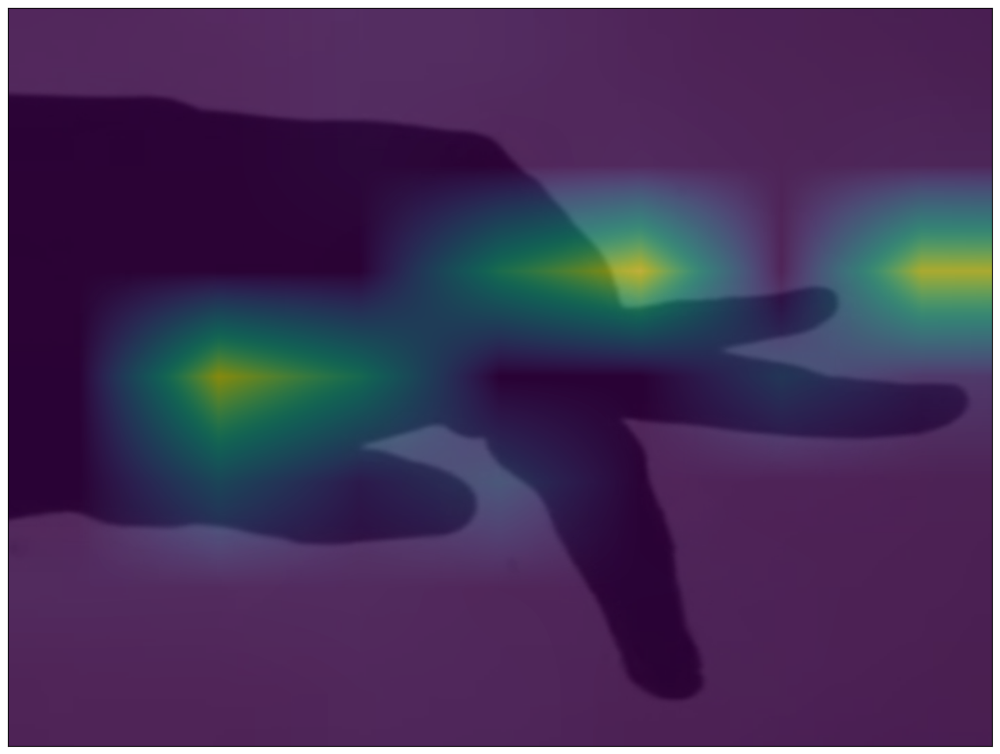

In [194]:
grad_cam(model7, model7.features.denseblock4.denselayer30.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/elephantFrames/elephant_471.PNG', 6)

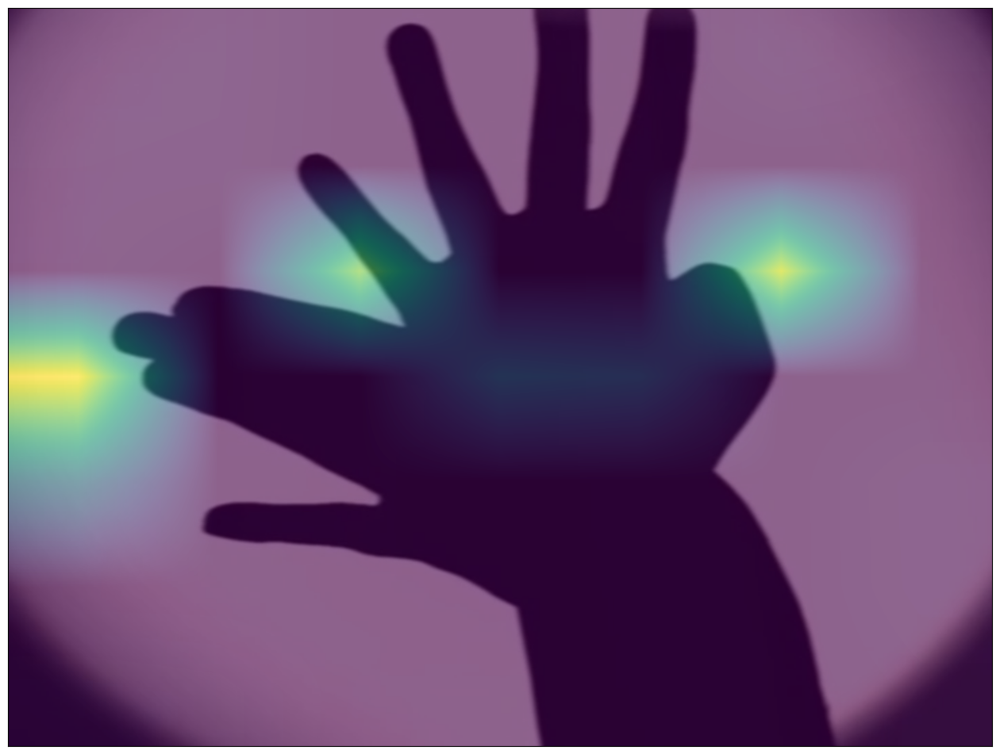

In [206]:
grad_cam(model7, model7.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/mooseFrames/moose_11.PNG', 7)

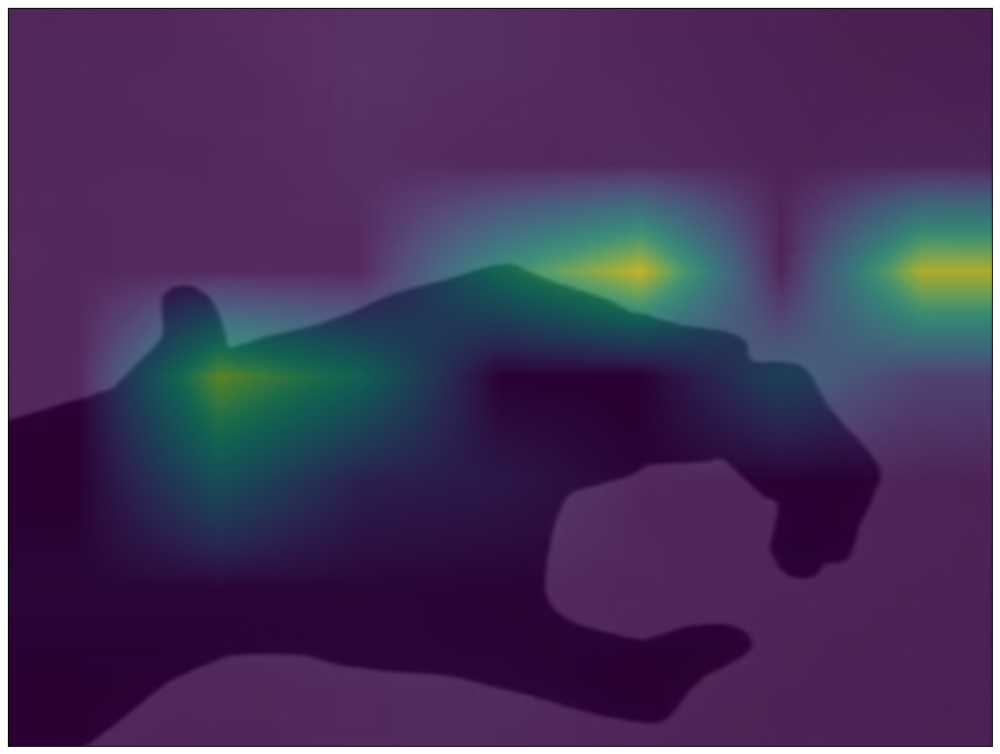

In [213]:
grad_cam(model7, model7.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/pantherFrames/panther_397.PNG', 8)

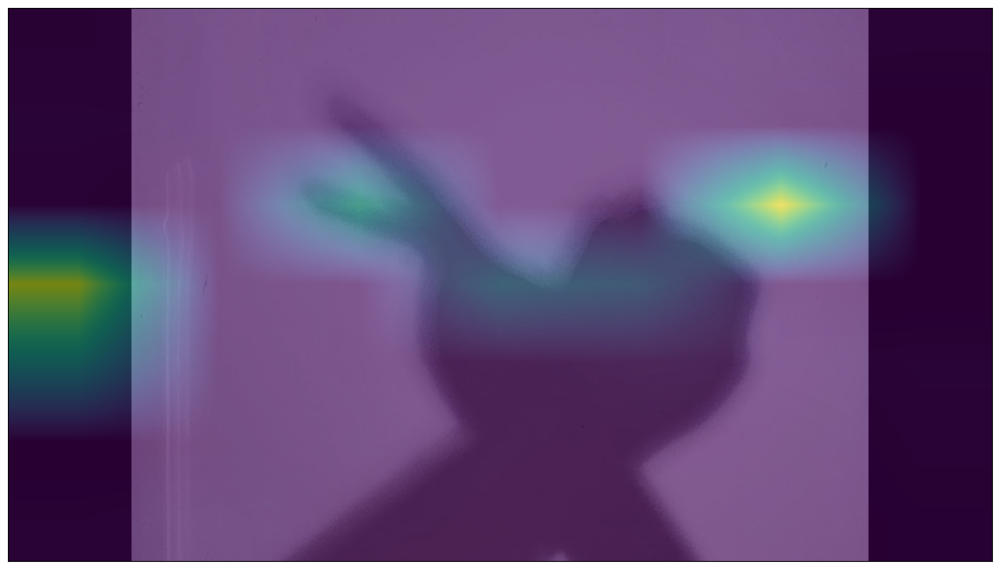

In [222]:
grad_cam(model7, model7.features.denseblock4.denselayer32.conv2, '/home/dlpc01/Rifat/CSE 4836 Pattern Recognition Lab/data2/val/snailFrames/snail_701.PNG', 10)